# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

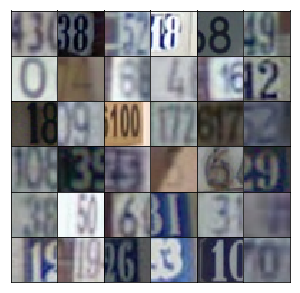

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha*x, x)
        
        x2 = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding="same")
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding="same")
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding="same")
        x = tf.maximum(alpha*x, x)
        
        x2 = tf.layers.conv2d(x, 128, 5, strides=2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha*x2, x2)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding="same")
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha*x3, x3)
        
        flatten = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flatten, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1643... Generator Loss: 0.9456
Epoch 1/25... Discriminator Loss: 0.3777... Generator Loss: 2.0124
Epoch 1/25... Discriminator Loss: 0.1919... Generator Loss: 2.2995
Epoch 1/25... Discriminator Loss: 0.1472... Generator Loss: 2.7745
Epoch 1/25... Discriminator Loss: 0.2305... Generator Loss: 2.4599
Epoch 1/25... Discriminator Loss: 0.1511... Generator Loss: 2.8108
Epoch 1/25... Discriminator Loss: 0.5858... Generator Loss: 1.8744
Epoch 1/25... Discriminator Loss: 0.9468... Generator Loss: 1.3455
Epoch 1/25... Discriminator Loss: 0.6675... Generator Loss: 1.5140
Epoch 1/25... Discriminator Loss: 0.4517... Generator Loss: 2.0686


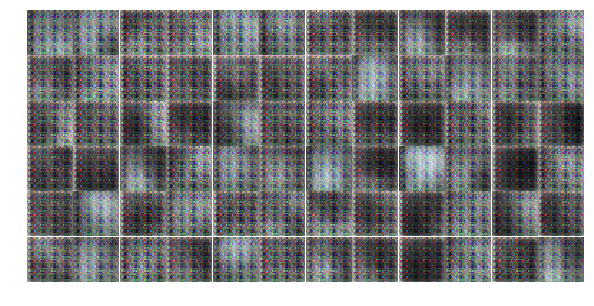

Epoch 1/25... Discriminator Loss: 0.5199... Generator Loss: 2.3477
Epoch 1/25... Discriminator Loss: 0.4401... Generator Loss: 1.3354
Epoch 1/25... Discriminator Loss: 0.4621... Generator Loss: 1.5552
Epoch 1/25... Discriminator Loss: 0.2051... Generator Loss: 2.7016
Epoch 1/25... Discriminator Loss: 0.5984... Generator Loss: 1.2603
Epoch 1/25... Discriminator Loss: 0.6711... Generator Loss: 1.0739
Epoch 1/25... Discriminator Loss: 0.3889... Generator Loss: 1.8535
Epoch 1/25... Discriminator Loss: 0.6436... Generator Loss: 0.9778
Epoch 1/25... Discriminator Loss: 0.4223... Generator Loss: 2.8597
Epoch 1/25... Discriminator Loss: 0.6285... Generator Loss: 4.4633


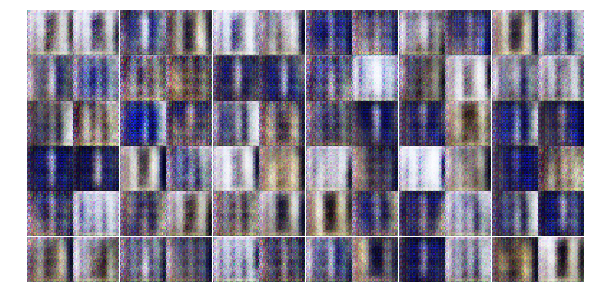

Epoch 1/25... Discriminator Loss: 0.6454... Generator Loss: 1.1582
Epoch 1/25... Discriminator Loss: 0.9820... Generator Loss: 0.9378
Epoch 1/25... Discriminator Loss: 0.4222... Generator Loss: 2.6486
Epoch 1/25... Discriminator Loss: 1.2693... Generator Loss: 2.1220
Epoch 1/25... Discriminator Loss: 0.8065... Generator Loss: 2.1175
Epoch 1/25... Discriminator Loss: 0.8985... Generator Loss: 1.1464
Epoch 1/25... Discriminator Loss: 1.1224... Generator Loss: 1.3984
Epoch 1/25... Discriminator Loss: 1.0320... Generator Loss: 1.3955
Epoch 1/25... Discriminator Loss: 0.8892... Generator Loss: 0.8421
Epoch 1/25... Discriminator Loss: 0.6295... Generator Loss: 1.4425


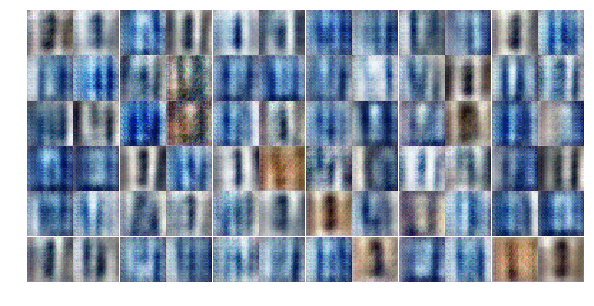

Epoch 1/25... Discriminator Loss: 0.6403... Generator Loss: 1.2150
Epoch 1/25... Discriminator Loss: 0.3338... Generator Loss: 2.5722
Epoch 1/25... Discriminator Loss: 0.6926... Generator Loss: 1.3214
Epoch 1/25... Discriminator Loss: 0.4804... Generator Loss: 1.6757
Epoch 1/25... Discriminator Loss: 0.6836... Generator Loss: 1.6264
Epoch 1/25... Discriminator Loss: 0.9283... Generator Loss: 0.8671
Epoch 1/25... Discriminator Loss: 0.7593... Generator Loss: 1.2631
Epoch 1/25... Discriminator Loss: 0.6427... Generator Loss: 2.0640
Epoch 1/25... Discriminator Loss: 0.8082... Generator Loss: 1.3547
Epoch 1/25... Discriminator Loss: 0.8932... Generator Loss: 1.1121


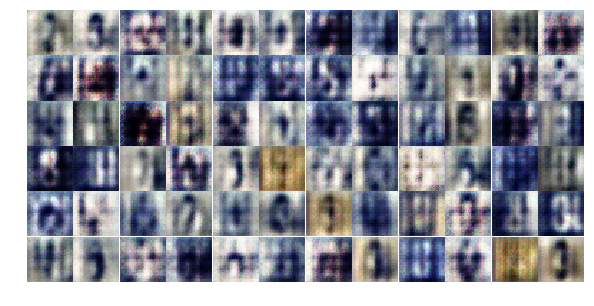

Epoch 1/25... Discriminator Loss: 0.7160... Generator Loss: 1.5622
Epoch 1/25... Discriminator Loss: 0.6499... Generator Loss: 1.4633
Epoch 1/25... Discriminator Loss: 0.9299... Generator Loss: 1.5198
Epoch 1/25... Discriminator Loss: 1.1786... Generator Loss: 0.6249
Epoch 1/25... Discriminator Loss: 0.9974... Generator Loss: 0.9061
Epoch 1/25... Discriminator Loss: 0.9084... Generator Loss: 1.0263
Epoch 1/25... Discriminator Loss: 0.7209... Generator Loss: 1.3472
Epoch 1/25... Discriminator Loss: 0.5942... Generator Loss: 1.4871
Epoch 1/25... Discriminator Loss: 0.3975... Generator Loss: 1.5921
Epoch 1/25... Discriminator Loss: 0.8410... Generator Loss: 1.0580


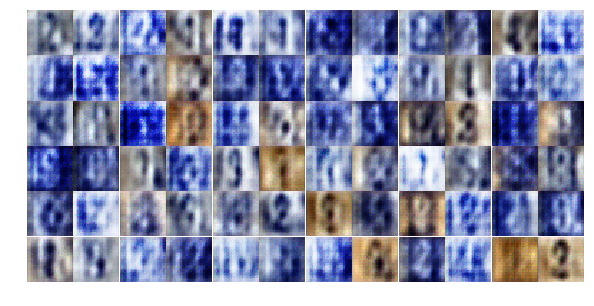

Epoch 1/25... Discriminator Loss: 0.9296... Generator Loss: 1.6974
Epoch 1/25... Discriminator Loss: 0.9893... Generator Loss: 1.0482
Epoch 1/25... Discriminator Loss: 0.9400... Generator Loss: 1.2719
Epoch 1/25... Discriminator Loss: 1.2629... Generator Loss: 0.5784
Epoch 1/25... Discriminator Loss: 0.8396... Generator Loss: 1.1377
Epoch 1/25... Discriminator Loss: 1.2030... Generator Loss: 0.9155
Epoch 1/25... Discriminator Loss: 0.8826... Generator Loss: 1.4384
Epoch 2/25... Discriminator Loss: 0.8792... Generator Loss: 1.1307
Epoch 2/25... Discriminator Loss: 0.9331... Generator Loss: 1.3668
Epoch 2/25... Discriminator Loss: 1.1088... Generator Loss: 0.7882


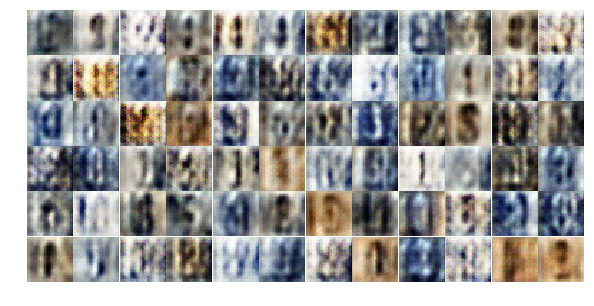

Epoch 2/25... Discriminator Loss: 1.7352... Generator Loss: 0.5420
Epoch 2/25... Discriminator Loss: 1.0265... Generator Loss: 0.9455
Epoch 2/25... Discriminator Loss: 1.0363... Generator Loss: 1.1439
Epoch 2/25... Discriminator Loss: 0.8672... Generator Loss: 1.0016
Epoch 2/25... Discriminator Loss: 1.1575... Generator Loss: 0.9070
Epoch 2/25... Discriminator Loss: 0.8414... Generator Loss: 1.2601
Epoch 2/25... Discriminator Loss: 0.7961... Generator Loss: 1.3791
Epoch 2/25... Discriminator Loss: 0.9552... Generator Loss: 1.5073
Epoch 2/25... Discriminator Loss: 1.5517... Generator Loss: 0.3584
Epoch 2/25... Discriminator Loss: 1.2556... Generator Loss: 0.8420


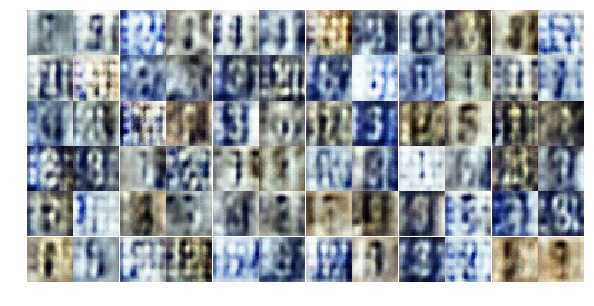

Epoch 2/25... Discriminator Loss: 0.9498... Generator Loss: 1.1232
Epoch 2/25... Discriminator Loss: 1.2670... Generator Loss: 0.8137
Epoch 2/25... Discriminator Loss: 0.6602... Generator Loss: 1.6734
Epoch 2/25... Discriminator Loss: 0.7423... Generator Loss: 1.3027
Epoch 2/25... Discriminator Loss: 0.9144... Generator Loss: 1.1769
Epoch 2/25... Discriminator Loss: 1.1395... Generator Loss: 0.8605
Epoch 2/25... Discriminator Loss: 1.1609... Generator Loss: 0.8469
Epoch 2/25... Discriminator Loss: 0.9682... Generator Loss: 0.9202
Epoch 2/25... Discriminator Loss: 0.9928... Generator Loss: 1.1178
Epoch 2/25... Discriminator Loss: 1.0796... Generator Loss: 0.6959


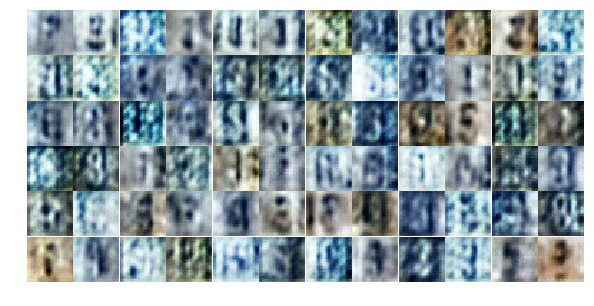

Epoch 2/25... Discriminator Loss: 1.1086... Generator Loss: 1.0032
Epoch 2/25... Discriminator Loss: 1.1292... Generator Loss: 0.6528
Epoch 2/25... Discriminator Loss: 0.8341... Generator Loss: 1.2114
Epoch 2/25... Discriminator Loss: 0.6826... Generator Loss: 1.6054
Epoch 2/25... Discriminator Loss: 1.0735... Generator Loss: 0.8740
Epoch 2/25... Discriminator Loss: 0.9306... Generator Loss: 1.0071
Epoch 2/25... Discriminator Loss: 1.4289... Generator Loss: 0.3791
Epoch 2/25... Discriminator Loss: 1.0846... Generator Loss: 0.9957
Epoch 2/25... Discriminator Loss: 0.8443... Generator Loss: 1.1363
Epoch 2/25... Discriminator Loss: 0.8760... Generator Loss: 0.9474


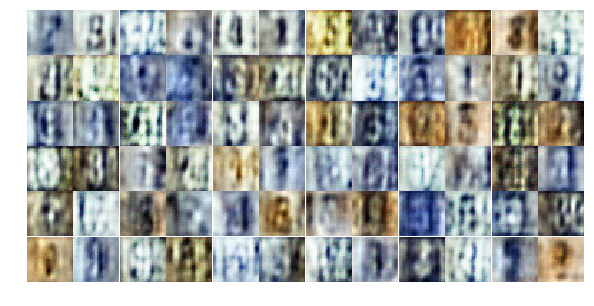

Epoch 2/25... Discriminator Loss: 0.6341... Generator Loss: 1.6881
Epoch 2/25... Discriminator Loss: 0.7928... Generator Loss: 0.9224
Epoch 2/25... Discriminator Loss: 1.2705... Generator Loss: 0.6121
Epoch 2/25... Discriminator Loss: 1.3330... Generator Loss: 0.5115
Epoch 2/25... Discriminator Loss: 0.8135... Generator Loss: 1.3714
Epoch 2/25... Discriminator Loss: 1.4040... Generator Loss: 0.6366
Epoch 2/25... Discriminator Loss: 1.1492... Generator Loss: 0.8839
Epoch 2/25... Discriminator Loss: 0.7417... Generator Loss: 2.2683
Epoch 2/25... Discriminator Loss: 1.4478... Generator Loss: 0.4183
Epoch 2/25... Discriminator Loss: 0.9000... Generator Loss: 0.7398


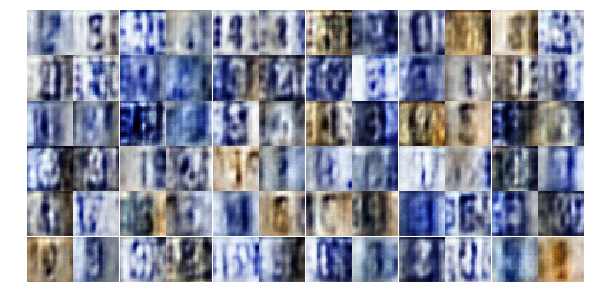

Epoch 2/25... Discriminator Loss: 0.6657... Generator Loss: 1.9421
Epoch 2/25... Discriminator Loss: 0.9948... Generator Loss: 1.0111
Epoch 2/25... Discriminator Loss: 0.9696... Generator Loss: 1.0493
Epoch 2/25... Discriminator Loss: 0.7029... Generator Loss: 2.1825
Epoch 2/25... Discriminator Loss: 1.2283... Generator Loss: 0.5712
Epoch 2/25... Discriminator Loss: 1.0032... Generator Loss: 0.7487
Epoch 2/25... Discriminator Loss: 0.5561... Generator Loss: 1.3930
Epoch 2/25... Discriminator Loss: 0.5500... Generator Loss: 2.6434
Epoch 2/25... Discriminator Loss: 1.2361... Generator Loss: 0.5429
Epoch 2/25... Discriminator Loss: 0.6208... Generator Loss: 1.9330


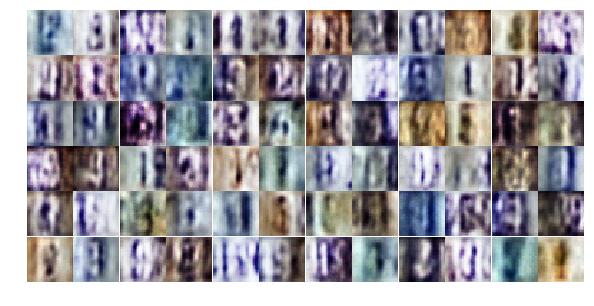

Epoch 2/25... Discriminator Loss: 0.5406... Generator Loss: 1.5387
Epoch 2/25... Discriminator Loss: 1.2262... Generator Loss: 0.5669
Epoch 2/25... Discriminator Loss: 1.3249... Generator Loss: 0.5301
Epoch 2/25... Discriminator Loss: 0.8138... Generator Loss: 1.1038
Epoch 3/25... Discriminator Loss: 0.4140... Generator Loss: 2.3999
Epoch 3/25... Discriminator Loss: 0.7561... Generator Loss: 1.0605
Epoch 3/25... Discriminator Loss: 0.9606... Generator Loss: 2.5679
Epoch 3/25... Discriminator Loss: 0.6848... Generator Loss: 0.9998
Epoch 3/25... Discriminator Loss: 0.5190... Generator Loss: 1.6814
Epoch 3/25... Discriminator Loss: 0.5391... Generator Loss: 1.4437


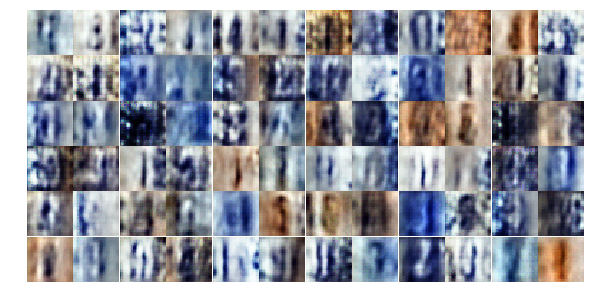

Epoch 3/25... Discriminator Loss: 0.3010... Generator Loss: 2.2537
Epoch 3/25... Discriminator Loss: 0.5371... Generator Loss: 1.7020
Epoch 3/25... Discriminator Loss: 1.4704... Generator Loss: 3.4658
Epoch 3/25... Discriminator Loss: 1.1669... Generator Loss: 0.5968
Epoch 3/25... Discriminator Loss: 1.2530... Generator Loss: 0.5611
Epoch 3/25... Discriminator Loss: 0.6383... Generator Loss: 1.4029
Epoch 3/25... Discriminator Loss: 0.6535... Generator Loss: 1.3133
Epoch 3/25... Discriminator Loss: 0.3396... Generator Loss: 2.4636
Epoch 3/25... Discriminator Loss: 0.6758... Generator Loss: 2.7682
Epoch 3/25... Discriminator Loss: 0.4271... Generator Loss: 1.8141


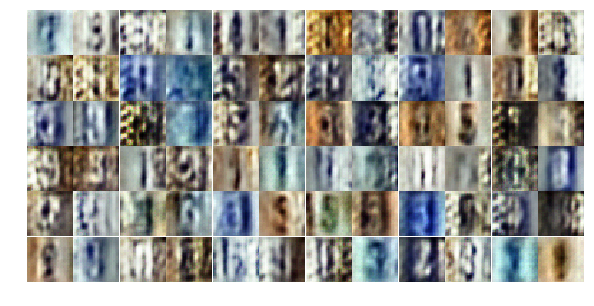

Epoch 3/25... Discriminator Loss: 0.6011... Generator Loss: 1.3181
Epoch 3/25... Discriminator Loss: 1.0958... Generator Loss: 0.7172
Epoch 3/25... Discriminator Loss: 0.5416... Generator Loss: 1.7226
Epoch 3/25... Discriminator Loss: 0.5295... Generator Loss: 1.3709
Epoch 3/25... Discriminator Loss: 0.5619... Generator Loss: 1.1686
Epoch 3/25... Discriminator Loss: 0.5175... Generator Loss: 1.4250
Epoch 3/25... Discriminator Loss: 1.2481... Generator Loss: 0.4929
Epoch 3/25... Discriminator Loss: 0.5186... Generator Loss: 1.4424
Epoch 3/25... Discriminator Loss: 0.5819... Generator Loss: 1.2180
Epoch 3/25... Discriminator Loss: 0.9545... Generator Loss: 0.8076


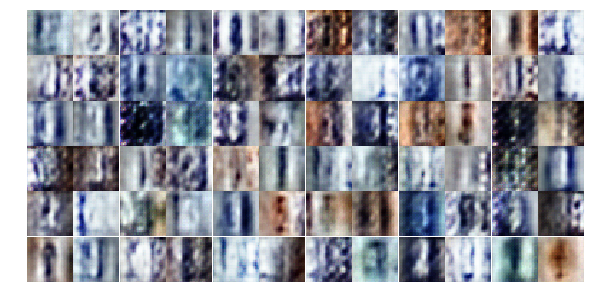

Epoch 3/25... Discriminator Loss: 1.0027... Generator Loss: 1.4991
Epoch 3/25... Discriminator Loss: 0.5637... Generator Loss: 2.3952
Epoch 3/25... Discriminator Loss: 0.6102... Generator Loss: 1.4834
Epoch 3/25... Discriminator Loss: 1.0774... Generator Loss: 1.3907
Epoch 3/25... Discriminator Loss: 0.6374... Generator Loss: 1.3179
Epoch 3/25... Discriminator Loss: 0.8007... Generator Loss: 1.0737
Epoch 3/25... Discriminator Loss: 0.7805... Generator Loss: 1.2049
Epoch 3/25... Discriminator Loss: 0.6367... Generator Loss: 2.7572
Epoch 3/25... Discriminator Loss: 0.5310... Generator Loss: 1.5485
Epoch 3/25... Discriminator Loss: 0.7627... Generator Loss: 1.1769


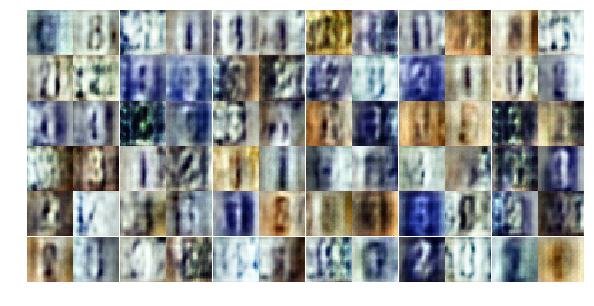

Epoch 3/25... Discriminator Loss: 1.2050... Generator Loss: 1.5018
Epoch 3/25... Discriminator Loss: 0.7053... Generator Loss: 1.7217
Epoch 3/25... Discriminator Loss: 0.8233... Generator Loss: 1.2860
Epoch 3/25... Discriminator Loss: 0.6417... Generator Loss: 1.2321
Epoch 3/25... Discriminator Loss: 0.7857... Generator Loss: 2.9615
Epoch 3/25... Discriminator Loss: 0.5906... Generator Loss: 1.3667
Epoch 3/25... Discriminator Loss: 0.7356... Generator Loss: 1.1432
Epoch 3/25... Discriminator Loss: 0.4315... Generator Loss: 1.7337
Epoch 3/25... Discriminator Loss: 0.4096... Generator Loss: 2.5595
Epoch 3/25... Discriminator Loss: 0.5226... Generator Loss: 1.9160


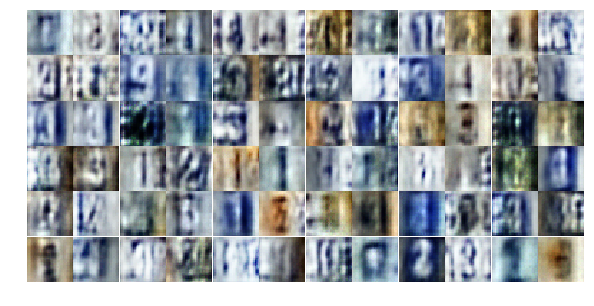

Epoch 3/25... Discriminator Loss: 0.3075... Generator Loss: 2.2764
Epoch 3/25... Discriminator Loss: 0.6955... Generator Loss: 1.5194
Epoch 3/25... Discriminator Loss: 0.5991... Generator Loss: 2.2922
Epoch 3/25... Discriminator Loss: 0.3303... Generator Loss: 2.5514
Epoch 3/25... Discriminator Loss: 0.6091... Generator Loss: 1.3832
Epoch 3/25... Discriminator Loss: 0.4106... Generator Loss: 1.6625
Epoch 3/25... Discriminator Loss: 0.8436... Generator Loss: 1.1361
Epoch 3/25... Discriminator Loss: 0.6178... Generator Loss: 2.3725
Epoch 3/25... Discriminator Loss: 0.7196... Generator Loss: 1.0344
Epoch 3/25... Discriminator Loss: 0.6042... Generator Loss: 1.9854


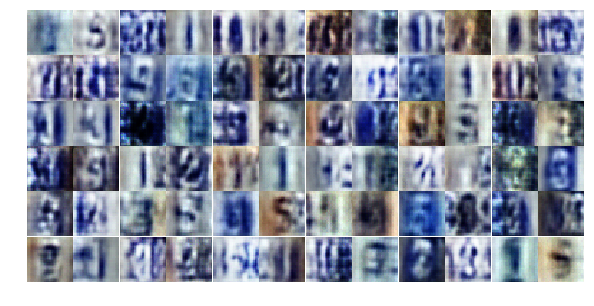

Epoch 3/25... Discriminator Loss: 0.9363... Generator Loss: 0.7202
Epoch 4/25... Discriminator Loss: 0.8380... Generator Loss: 2.0307
Epoch 4/25... Discriminator Loss: 0.8662... Generator Loss: 0.8652
Epoch 4/25... Discriminator Loss: 1.0217... Generator Loss: 0.7210
Epoch 4/25... Discriminator Loss: 0.4709... Generator Loss: 1.6012
Epoch 4/25... Discriminator Loss: 0.9637... Generator Loss: 0.7631
Epoch 4/25... Discriminator Loss: 0.7139... Generator Loss: 1.7486
Epoch 4/25... Discriminator Loss: 0.5516... Generator Loss: 1.5477
Epoch 4/25... Discriminator Loss: 0.6766... Generator Loss: 0.9657
Epoch 4/25... Discriminator Loss: 0.6357... Generator Loss: 1.4649


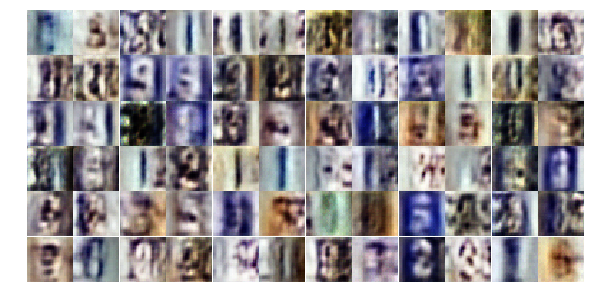

Epoch 4/25... Discriminator Loss: 0.5577... Generator Loss: 1.9676
Epoch 4/25... Discriminator Loss: 0.4322... Generator Loss: 1.8336
Epoch 4/25... Discriminator Loss: 0.8413... Generator Loss: 0.8919
Epoch 4/25... Discriminator Loss: 0.4949... Generator Loss: 2.0596
Epoch 4/25... Discriminator Loss: 1.3561... Generator Loss: 2.9422
Epoch 4/25... Discriminator Loss: 1.4185... Generator Loss: 0.3772
Epoch 4/25... Discriminator Loss: 1.3896... Generator Loss: 0.4225
Epoch 4/25... Discriminator Loss: 0.5059... Generator Loss: 1.4493
Epoch 4/25... Discriminator Loss: 0.5332... Generator Loss: 1.3318
Epoch 4/25... Discriminator Loss: 0.4005... Generator Loss: 1.9967


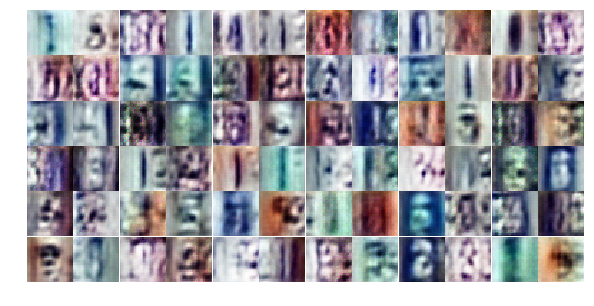

Epoch 4/25... Discriminator Loss: 0.5370... Generator Loss: 1.9667
Epoch 4/25... Discriminator Loss: 0.4006... Generator Loss: 1.7604
Epoch 4/25... Discriminator Loss: 0.9323... Generator Loss: 0.7025
Epoch 4/25... Discriminator Loss: 0.4165... Generator Loss: 1.6461
Epoch 4/25... Discriminator Loss: 0.5497... Generator Loss: 1.3953
Epoch 4/25... Discriminator Loss: 0.3440... Generator Loss: 2.3338
Epoch 4/25... Discriminator Loss: 0.4292... Generator Loss: 1.6620
Epoch 4/25... Discriminator Loss: 0.6933... Generator Loss: 0.9370
Epoch 4/25... Discriminator Loss: 0.6426... Generator Loss: 1.8863
Epoch 4/25... Discriminator Loss: 0.7338... Generator Loss: 0.9418


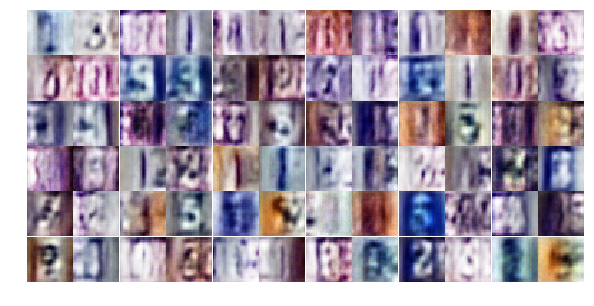

Epoch 4/25... Discriminator Loss: 0.4528... Generator Loss: 1.6975
Epoch 4/25... Discriminator Loss: 0.5854... Generator Loss: 1.3426
Epoch 4/25... Discriminator Loss: 1.2854... Generator Loss: 0.4319
Epoch 4/25... Discriminator Loss: 0.4442... Generator Loss: 2.3206
Epoch 4/25... Discriminator Loss: 0.3256... Generator Loss: 2.5714
Epoch 4/25... Discriminator Loss: 0.3186... Generator Loss: 1.8481
Epoch 4/25... Discriminator Loss: 0.9226... Generator Loss: 0.7517
Epoch 4/25... Discriminator Loss: 0.4629... Generator Loss: 1.4973
Epoch 4/25... Discriminator Loss: 0.4542... Generator Loss: 2.3026
Epoch 4/25... Discriminator Loss: 0.4220... Generator Loss: 1.6676


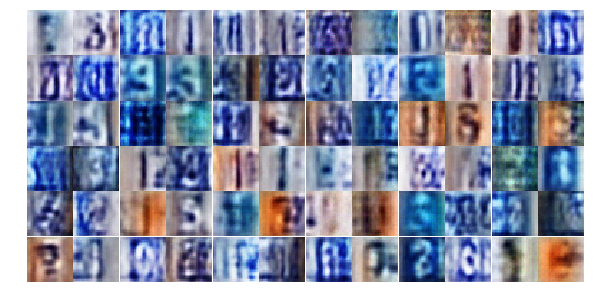

Epoch 4/25... Discriminator Loss: 0.4850... Generator Loss: 1.5366
Epoch 4/25... Discriminator Loss: 0.4367... Generator Loss: 1.5888
Epoch 4/25... Discriminator Loss: 0.7556... Generator Loss: 0.8985
Epoch 4/25... Discriminator Loss: 0.3531... Generator Loss: 2.0997
Epoch 4/25... Discriminator Loss: 0.5943... Generator Loss: 1.2549
Epoch 4/25... Discriminator Loss: 0.6887... Generator Loss: 1.5011
Epoch 4/25... Discriminator Loss: 1.0397... Generator Loss: 0.6263
Epoch 4/25... Discriminator Loss: 0.3787... Generator Loss: 1.6935
Epoch 4/25... Discriminator Loss: 0.6923... Generator Loss: 1.3515
Epoch 4/25... Discriminator Loss: 0.5254... Generator Loss: 1.4927


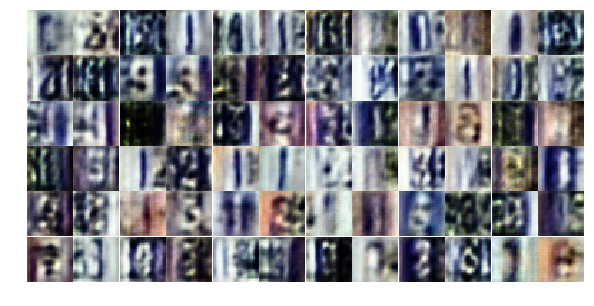

Epoch 4/25... Discriminator Loss: 0.4384... Generator Loss: 1.7328
Epoch 4/25... Discriminator Loss: 0.4568... Generator Loss: 1.6789
Epoch 4/25... Discriminator Loss: 0.5418... Generator Loss: 1.7640
Epoch 4/25... Discriminator Loss: 0.4442... Generator Loss: 1.5657
Epoch 4/25... Discriminator Loss: 0.4237... Generator Loss: 1.7884
Epoch 4/25... Discriminator Loss: 0.6308... Generator Loss: 1.4235
Epoch 4/25... Discriminator Loss: 0.7367... Generator Loss: 0.9892
Epoch 4/25... Discriminator Loss: 0.7810... Generator Loss: 1.1598
Epoch 4/25... Discriminator Loss: 0.4655... Generator Loss: 1.5462
Epoch 5/25... Discriminator Loss: 0.6271... Generator Loss: 1.1683


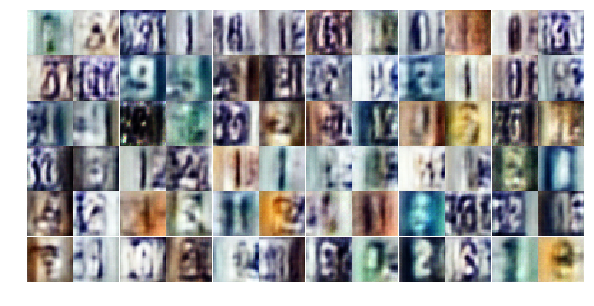

Epoch 5/25... Discriminator Loss: 0.7018... Generator Loss: 1.0472
Epoch 5/25... Discriminator Loss: 0.4040... Generator Loss: 1.7919
Epoch 5/25... Discriminator Loss: 0.4754... Generator Loss: 1.4646
Epoch 5/25... Discriminator Loss: 0.6439... Generator Loss: 0.9634
Epoch 5/25... Discriminator Loss: 0.3243... Generator Loss: 2.7383
Epoch 5/25... Discriminator Loss: 0.3253... Generator Loss: 1.9724
Epoch 5/25... Discriminator Loss: 0.5068... Generator Loss: 2.3855
Epoch 5/25... Discriminator Loss: 0.3911... Generator Loss: 3.0720
Epoch 5/25... Discriminator Loss: 0.7885... Generator Loss: 1.3645
Epoch 5/25... Discriminator Loss: 1.2579... Generator Loss: 0.8089


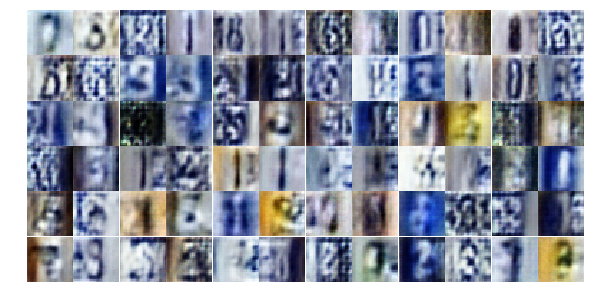

Epoch 5/25... Discriminator Loss: 0.7029... Generator Loss: 1.3379
Epoch 5/25... Discriminator Loss: 0.5018... Generator Loss: 2.0003
Epoch 5/25... Discriminator Loss: 0.4035... Generator Loss: 1.6193
Epoch 5/25... Discriminator Loss: 0.4484... Generator Loss: 1.8686
Epoch 5/25... Discriminator Loss: 0.3870... Generator Loss: 1.8974
Epoch 5/25... Discriminator Loss: 0.6316... Generator Loss: 1.3942
Epoch 5/25... Discriminator Loss: 0.5160... Generator Loss: 1.4645
Epoch 5/25... Discriminator Loss: 0.4006... Generator Loss: 1.7485
Epoch 5/25... Discriminator Loss: 0.3911... Generator Loss: 1.5701
Epoch 5/25... Discriminator Loss: 0.5364... Generator Loss: 1.5197


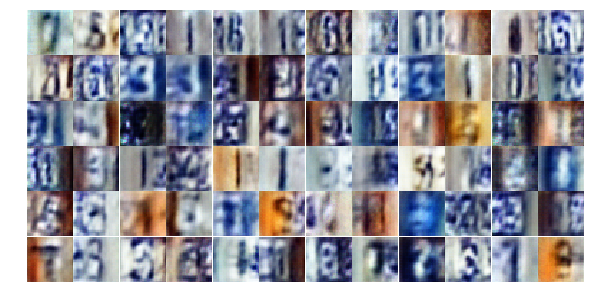

Epoch 5/25... Discriminator Loss: 0.6833... Generator Loss: 1.0019
Epoch 5/25... Discriminator Loss: 1.7371... Generator Loss: 0.3685
Epoch 5/25... Discriminator Loss: 0.9299... Generator Loss: 0.8073
Epoch 5/25... Discriminator Loss: 0.6061... Generator Loss: 1.3360
Epoch 5/25... Discriminator Loss: 1.4121... Generator Loss: 3.0627
Epoch 5/25... Discriminator Loss: 0.5466... Generator Loss: 1.2572
Epoch 5/25... Discriminator Loss: 0.5272... Generator Loss: 1.3191
Epoch 5/25... Discriminator Loss: 0.4141... Generator Loss: 1.7320
Epoch 5/25... Discriminator Loss: 0.3689... Generator Loss: 1.6155
Epoch 5/25... Discriminator Loss: 0.3032... Generator Loss: 1.8153


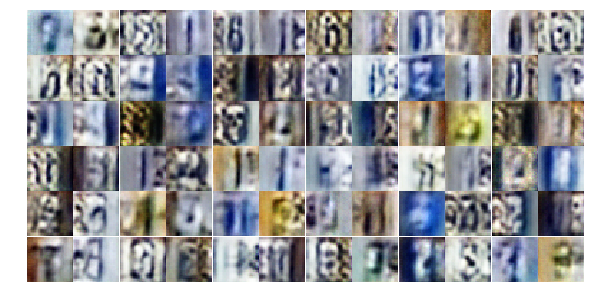

Epoch 5/25... Discriminator Loss: 0.6822... Generator Loss: 1.2537
Epoch 5/25... Discriminator Loss: 0.4553... Generator Loss: 1.5179
Epoch 5/25... Discriminator Loss: 0.7352... Generator Loss: 1.0522
Epoch 5/25... Discriminator Loss: 0.4770... Generator Loss: 1.4697
Epoch 5/25... Discriminator Loss: 0.5516... Generator Loss: 2.3406
Epoch 5/25... Discriminator Loss: 0.4720... Generator Loss: 1.6021
Epoch 5/25... Discriminator Loss: 0.3387... Generator Loss: 1.9156
Epoch 5/25... Discriminator Loss: 0.3779... Generator Loss: 1.6219
Epoch 5/25... Discriminator Loss: 0.8003... Generator Loss: 0.8366
Epoch 5/25... Discriminator Loss: 0.7343... Generator Loss: 0.8677


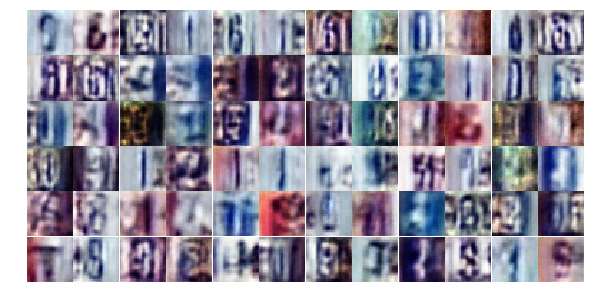

Epoch 5/25... Discriminator Loss: 0.4004... Generator Loss: 1.7189
Epoch 5/25... Discriminator Loss: 0.3691... Generator Loss: 1.5911
Epoch 5/25... Discriminator Loss: 1.0356... Generator Loss: 0.5601
Epoch 5/25... Discriminator Loss: 0.6434... Generator Loss: 1.2924
Epoch 5/25... Discriminator Loss: 1.1311... Generator Loss: 1.0135
Epoch 5/25... Discriminator Loss: 2.1299... Generator Loss: 3.4948
Epoch 5/25... Discriminator Loss: 0.4657... Generator Loss: 1.9226
Epoch 5/25... Discriminator Loss: 0.5788... Generator Loss: 1.5375
Epoch 5/25... Discriminator Loss: 0.7089... Generator Loss: 0.9110
Epoch 5/25... Discriminator Loss: 0.5437... Generator Loss: 2.0545


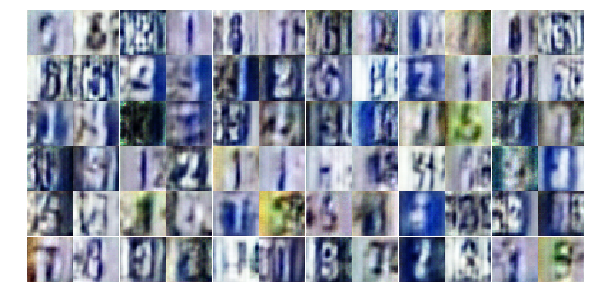

Epoch 5/25... Discriminator Loss: 0.9343... Generator Loss: 0.9210
Epoch 5/25... Discriminator Loss: 0.5912... Generator Loss: 1.1499
Epoch 5/25... Discriminator Loss: 1.0048... Generator Loss: 0.5986
Epoch 5/25... Discriminator Loss: 0.4919... Generator Loss: 1.7540
Epoch 5/25... Discriminator Loss: 0.5211... Generator Loss: 1.4695
Epoch 5/25... Discriminator Loss: 0.4813... Generator Loss: 1.4032
Epoch 6/25... Discriminator Loss: 0.4952... Generator Loss: 2.6363
Epoch 6/25... Discriminator Loss: 0.3937... Generator Loss: 2.3382
Epoch 6/25... Discriminator Loss: 1.0693... Generator Loss: 0.7259
Epoch 6/25... Discriminator Loss: 1.0941... Generator Loss: 0.5812


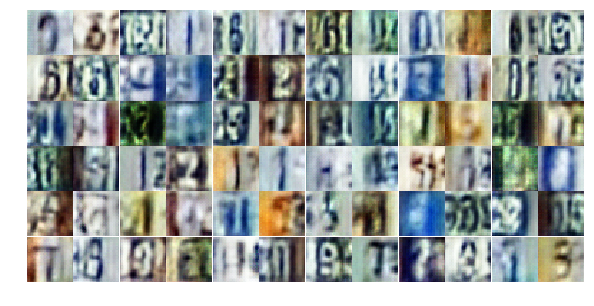

Epoch 6/25... Discriminator Loss: 0.7397... Generator Loss: 1.0289
Epoch 6/25... Discriminator Loss: 0.5598... Generator Loss: 1.4463
Epoch 6/25... Discriminator Loss: 0.5701... Generator Loss: 1.2031
Epoch 6/25... Discriminator Loss: 0.7439... Generator Loss: 0.9795
Epoch 6/25... Discriminator Loss: 0.6810... Generator Loss: 1.0237
Epoch 6/25... Discriminator Loss: 0.4218... Generator Loss: 1.5784
Epoch 6/25... Discriminator Loss: 0.4169... Generator Loss: 1.4423
Epoch 6/25... Discriminator Loss: 0.6848... Generator Loss: 1.4842
Epoch 6/25... Discriminator Loss: 0.6443... Generator Loss: 1.0382
Epoch 6/25... Discriminator Loss: 0.5508... Generator Loss: 1.5133


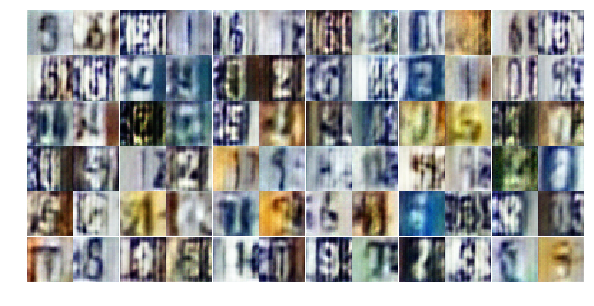

Epoch 6/25... Discriminator Loss: 0.7057... Generator Loss: 2.4924
Epoch 6/25... Discriminator Loss: 1.2749... Generator Loss: 0.5307
Epoch 6/25... Discriminator Loss: 0.6895... Generator Loss: 0.9160
Epoch 6/25... Discriminator Loss: 0.9375... Generator Loss: 0.7071
Epoch 6/25... Discriminator Loss: 0.5071... Generator Loss: 1.5188
Epoch 6/25... Discriminator Loss: 0.5394... Generator Loss: 1.7625
Epoch 6/25... Discriminator Loss: 0.3569... Generator Loss: 2.1544
Epoch 6/25... Discriminator Loss: 0.7263... Generator Loss: 0.9735
Epoch 6/25... Discriminator Loss: 0.6322... Generator Loss: 2.1247
Epoch 6/25... Discriminator Loss: 0.7878... Generator Loss: 0.8477


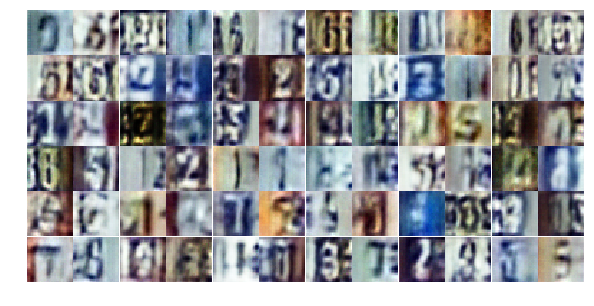

Epoch 6/25... Discriminator Loss: 0.8437... Generator Loss: 0.7991
Epoch 6/25... Discriminator Loss: 1.1030... Generator Loss: 2.6843
Epoch 6/25... Discriminator Loss: 0.9621... Generator Loss: 0.6639
Epoch 6/25... Discriminator Loss: 0.9324... Generator Loss: 0.6864
Epoch 6/25... Discriminator Loss: 0.4248... Generator Loss: 2.0489
Epoch 6/25... Discriminator Loss: 1.0320... Generator Loss: 0.7278
Epoch 6/25... Discriminator Loss: 0.6859... Generator Loss: 1.1699
Epoch 6/25... Discriminator Loss: 0.4126... Generator Loss: 1.5281
Epoch 6/25... Discriminator Loss: 0.4822... Generator Loss: 1.2945
Epoch 6/25... Discriminator Loss: 0.4697... Generator Loss: 1.4607


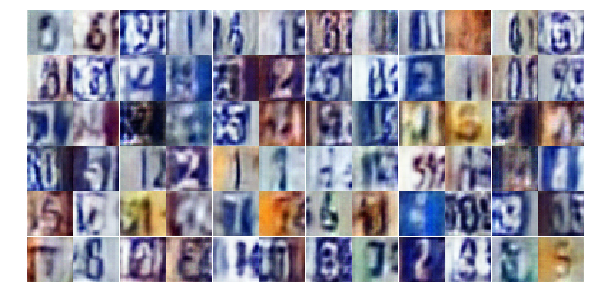

Epoch 6/25... Discriminator Loss: 1.2703... Generator Loss: 0.4290
Epoch 6/25... Discriminator Loss: 0.6278... Generator Loss: 1.5714
Epoch 6/25... Discriminator Loss: 0.9025... Generator Loss: 0.7290
Epoch 6/25... Discriminator Loss: 0.4377... Generator Loss: 1.4086
Epoch 6/25... Discriminator Loss: 0.8056... Generator Loss: 0.8884
Epoch 6/25... Discriminator Loss: 0.7087... Generator Loss: 0.9512
Epoch 6/25... Discriminator Loss: 0.5288... Generator Loss: 1.6434
Epoch 6/25... Discriminator Loss: 0.3816... Generator Loss: 1.7716
Epoch 6/25... Discriminator Loss: 1.4076... Generator Loss: 0.3779
Epoch 6/25... Discriminator Loss: 0.5298... Generator Loss: 1.2135


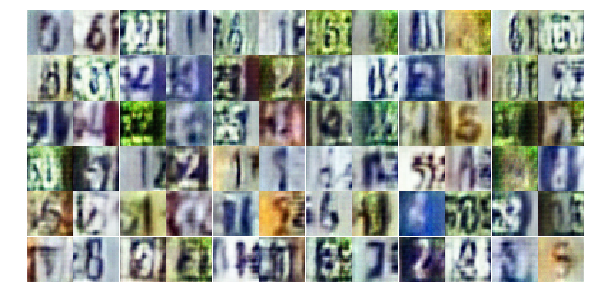

Epoch 6/25... Discriminator Loss: 1.1154... Generator Loss: 3.5433
Epoch 6/25... Discriminator Loss: 1.1024... Generator Loss: 1.9898
Epoch 6/25... Discriminator Loss: 0.9026... Generator Loss: 0.9648
Epoch 6/25... Discriminator Loss: 0.5930... Generator Loss: 1.5010
Epoch 6/25... Discriminator Loss: 0.5117... Generator Loss: 1.8832
Epoch 6/25... Discriminator Loss: 0.6804... Generator Loss: 1.1200
Epoch 6/25... Discriminator Loss: 0.6676... Generator Loss: 0.9768
Epoch 6/25... Discriminator Loss: 1.3528... Generator Loss: 0.3854
Epoch 6/25... Discriminator Loss: 0.4760... Generator Loss: 1.4828
Epoch 6/25... Discriminator Loss: 1.6282... Generator Loss: 0.3085


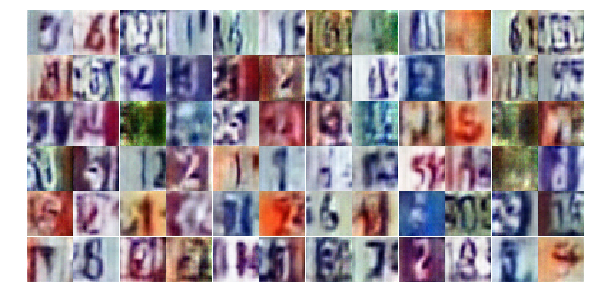

Epoch 6/25... Discriminator Loss: 0.6453... Generator Loss: 2.2985
Epoch 6/25... Discriminator Loss: 0.5848... Generator Loss: 1.2502
Epoch 6/25... Discriminator Loss: 0.7039... Generator Loss: 1.0583
Epoch 7/25... Discriminator Loss: 0.6614... Generator Loss: 1.4312
Epoch 7/25... Discriminator Loss: 0.5438... Generator Loss: 1.7277
Epoch 7/25... Discriminator Loss: 0.8208... Generator Loss: 0.9137
Epoch 7/25... Discriminator Loss: 0.5843... Generator Loss: 1.1591
Epoch 7/25... Discriminator Loss: 0.5933... Generator Loss: 1.5867
Epoch 7/25... Discriminator Loss: 0.6495... Generator Loss: 2.3376
Epoch 7/25... Discriminator Loss: 0.9616... Generator Loss: 0.7942


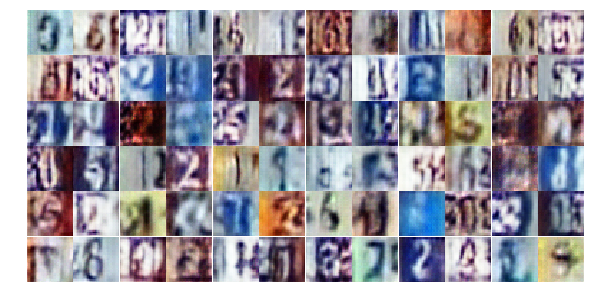

Epoch 7/25... Discriminator Loss: 0.8109... Generator Loss: 0.9892
Epoch 7/25... Discriminator Loss: 0.9647... Generator Loss: 0.6647
Epoch 7/25... Discriminator Loss: 0.8364... Generator Loss: 0.8475
Epoch 7/25... Discriminator Loss: 0.6548... Generator Loss: 1.3356
Epoch 7/25... Discriminator Loss: 0.4059... Generator Loss: 1.5453
Epoch 7/25... Discriminator Loss: 0.7689... Generator Loss: 0.9114
Epoch 7/25... Discriminator Loss: 1.1209... Generator Loss: 3.1471
Epoch 7/25... Discriminator Loss: 0.8739... Generator Loss: 2.6197
Epoch 7/25... Discriminator Loss: 0.9773... Generator Loss: 2.5963
Epoch 7/25... Discriminator Loss: 0.7823... Generator Loss: 0.8312


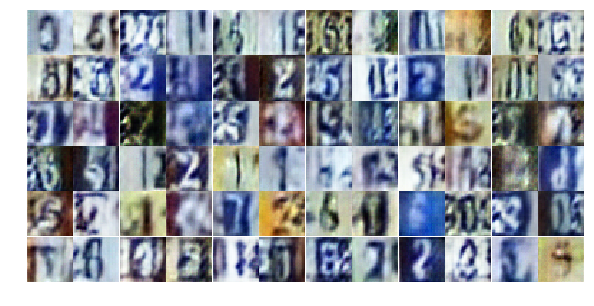

Epoch 7/25... Discriminator Loss: 0.7063... Generator Loss: 1.4217
Epoch 7/25... Discriminator Loss: 0.4189... Generator Loss: 1.9526
Epoch 7/25... Discriminator Loss: 1.0559... Generator Loss: 0.5762
Epoch 7/25... Discriminator Loss: 0.5296... Generator Loss: 1.5852
Epoch 7/25... Discriminator Loss: 0.5105... Generator Loss: 1.3584
Epoch 7/25... Discriminator Loss: 0.3487... Generator Loss: 2.6212
Epoch 7/25... Discriminator Loss: 0.4883... Generator Loss: 1.3577
Epoch 7/25... Discriminator Loss: 0.9143... Generator Loss: 0.8261
Epoch 7/25... Discriminator Loss: 0.4814... Generator Loss: 1.8951
Epoch 7/25... Discriminator Loss: 0.8351... Generator Loss: 2.4487


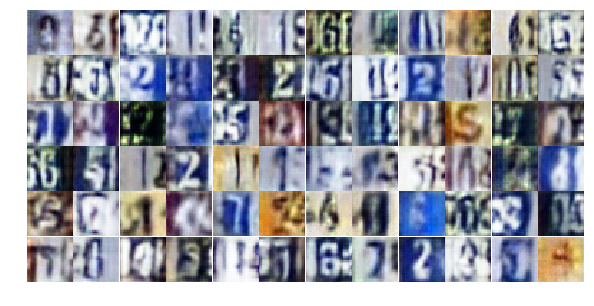

Epoch 7/25... Discriminator Loss: 0.7270... Generator Loss: 1.1511
Epoch 7/25... Discriminator Loss: 0.6683... Generator Loss: 1.1283
Epoch 7/25... Discriminator Loss: 0.5152... Generator Loss: 1.4322
Epoch 7/25... Discriminator Loss: 0.6866... Generator Loss: 0.9694
Epoch 7/25... Discriminator Loss: 0.7506... Generator Loss: 0.8065
Epoch 7/25... Discriminator Loss: 0.6712... Generator Loss: 0.9988
Epoch 7/25... Discriminator Loss: 0.8904... Generator Loss: 0.7397
Epoch 7/25... Discriminator Loss: 1.1017... Generator Loss: 0.5781
Epoch 7/25... Discriminator Loss: 1.1189... Generator Loss: 0.5756
Epoch 7/25... Discriminator Loss: 0.5764... Generator Loss: 2.0637


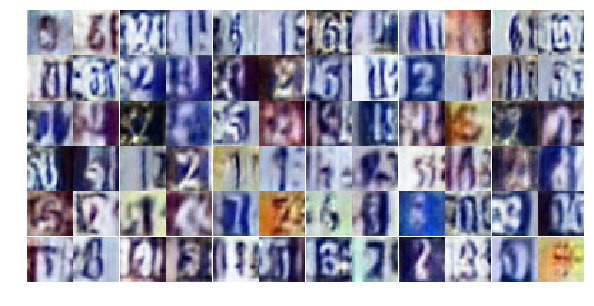

Epoch 7/25... Discriminator Loss: 0.8453... Generator Loss: 0.9181
Epoch 7/25... Discriminator Loss: 0.7367... Generator Loss: 1.2813
Epoch 7/25... Discriminator Loss: 0.4177... Generator Loss: 1.7333
Epoch 7/25... Discriminator Loss: 0.9536... Generator Loss: 0.6332
Epoch 7/25... Discriminator Loss: 0.8991... Generator Loss: 0.7885
Epoch 7/25... Discriminator Loss: 0.3490... Generator Loss: 2.2472
Epoch 7/25... Discriminator Loss: 0.5895... Generator Loss: 1.2355
Epoch 7/25... Discriminator Loss: 0.7135... Generator Loss: 1.1983
Epoch 7/25... Discriminator Loss: 0.2428... Generator Loss: 2.8717
Epoch 7/25... Discriminator Loss: 1.3554... Generator Loss: 1.1943


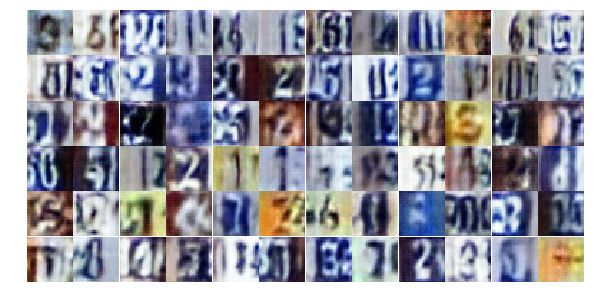

Epoch 7/25... Discriminator Loss: 0.5108... Generator Loss: 1.6921
Epoch 7/25... Discriminator Loss: 0.8388... Generator Loss: 0.8628
Epoch 7/25... Discriminator Loss: 0.8358... Generator Loss: 0.9359
Epoch 7/25... Discriminator Loss: 0.6603... Generator Loss: 1.0734
Epoch 7/25... Discriminator Loss: 0.5924... Generator Loss: 1.3440
Epoch 7/25... Discriminator Loss: 0.5748... Generator Loss: 1.3394
Epoch 7/25... Discriminator Loss: 1.6450... Generator Loss: 0.3030
Epoch 7/25... Discriminator Loss: 0.6673... Generator Loss: 1.1692
Epoch 7/25... Discriminator Loss: 0.9216... Generator Loss: 1.6875
Epoch 7/25... Discriminator Loss: 0.8751... Generator Loss: 0.8209


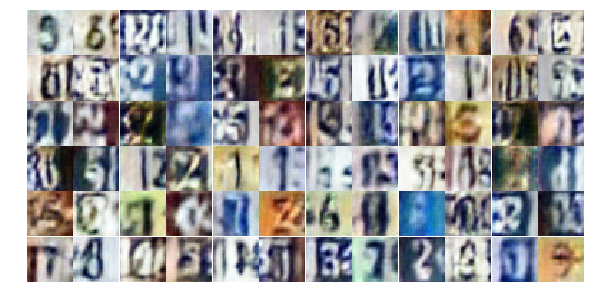

Epoch 7/25... Discriminator Loss: 0.5650... Generator Loss: 1.9514
Epoch 8/25... Discriminator Loss: 0.7596... Generator Loss: 0.8687
Epoch 8/25... Discriminator Loss: 0.6768... Generator Loss: 0.9463
Epoch 8/25... Discriminator Loss: 0.6917... Generator Loss: 0.9912
Epoch 8/25... Discriminator Loss: 0.6317... Generator Loss: 1.1562
Epoch 8/25... Discriminator Loss: 0.9513... Generator Loss: 0.7461
Epoch 8/25... Discriminator Loss: 0.6591... Generator Loss: 1.0168
Epoch 8/25... Discriminator Loss: 0.4605... Generator Loss: 1.7907
Epoch 8/25... Discriminator Loss: 0.7659... Generator Loss: 1.0002
Epoch 8/25... Discriminator Loss: 0.6339... Generator Loss: 1.5140


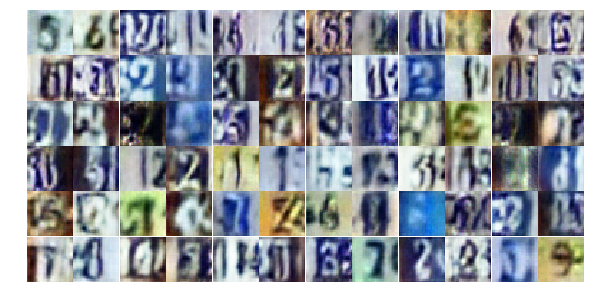

Epoch 8/25... Discriminator Loss: 0.3797... Generator Loss: 1.9974
Epoch 8/25... Discriminator Loss: 0.5539... Generator Loss: 1.3887
Epoch 8/25... Discriminator Loss: 0.6549... Generator Loss: 1.4378
Epoch 8/25... Discriminator Loss: 0.5496... Generator Loss: 2.2191
Epoch 8/25... Discriminator Loss: 1.1172... Generator Loss: 0.5802
Epoch 8/25... Discriminator Loss: 0.5039... Generator Loss: 1.6088
Epoch 8/25... Discriminator Loss: 1.1856... Generator Loss: 0.5486
Epoch 8/25... Discriminator Loss: 0.4992... Generator Loss: 1.5412
Epoch 8/25... Discriminator Loss: 0.6329... Generator Loss: 0.9983
Epoch 8/25... Discriminator Loss: 1.3575... Generator Loss: 0.3840


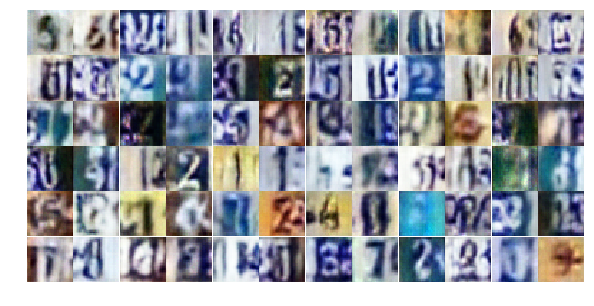

Epoch 8/25... Discriminator Loss: 0.3855... Generator Loss: 1.8816
Epoch 8/25... Discriminator Loss: 0.4930... Generator Loss: 1.4221
Epoch 8/25... Discriminator Loss: 0.7452... Generator Loss: 0.9091
Epoch 8/25... Discriminator Loss: 0.6247... Generator Loss: 1.6721
Epoch 8/25... Discriminator Loss: 0.3746... Generator Loss: 1.6753
Epoch 8/25... Discriminator Loss: 0.5829... Generator Loss: 1.2275
Epoch 8/25... Discriminator Loss: 1.0691... Generator Loss: 3.2970
Epoch 8/25... Discriminator Loss: 1.3667... Generator Loss: 0.5535
Epoch 8/25... Discriminator Loss: 0.8595... Generator Loss: 2.1682
Epoch 8/25... Discriminator Loss: 0.7369... Generator Loss: 1.2053


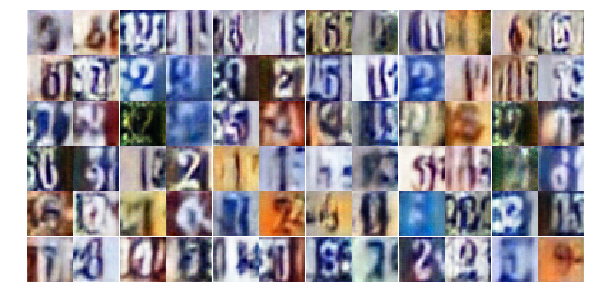

Epoch 8/25... Discriminator Loss: 0.6510... Generator Loss: 1.2865
Epoch 8/25... Discriminator Loss: 0.9490... Generator Loss: 0.7366
Epoch 8/25... Discriminator Loss: 1.0688... Generator Loss: 0.6180
Epoch 8/25... Discriminator Loss: 0.8096... Generator Loss: 0.8829
Epoch 8/25... Discriminator Loss: 0.6492... Generator Loss: 0.9959
Epoch 8/25... Discriminator Loss: 0.7994... Generator Loss: 0.8377
Epoch 8/25... Discriminator Loss: 0.7579... Generator Loss: 0.9653
Epoch 8/25... Discriminator Loss: 0.4047... Generator Loss: 1.7777
Epoch 8/25... Discriminator Loss: 0.6167... Generator Loss: 1.1960
Epoch 8/25... Discriminator Loss: 0.4501... Generator Loss: 1.3783


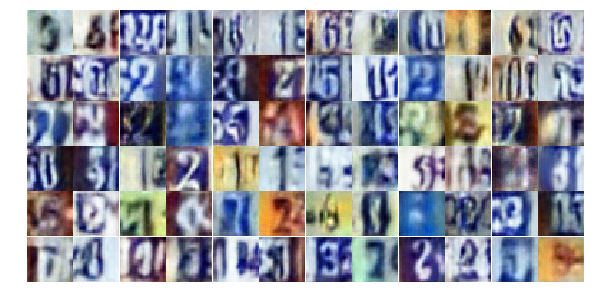

Epoch 8/25... Discriminator Loss: 0.5009... Generator Loss: 1.2859
Epoch 8/25... Discriminator Loss: 0.8879... Generator Loss: 0.7176
Epoch 8/25... Discriminator Loss: 0.7615... Generator Loss: 0.8758
Epoch 8/25... Discriminator Loss: 0.4390... Generator Loss: 1.5699
Epoch 8/25... Discriminator Loss: 0.5474... Generator Loss: 1.3525
Epoch 8/25... Discriminator Loss: 1.1786... Generator Loss: 0.4865
Epoch 8/25... Discriminator Loss: 0.4168... Generator Loss: 1.9204
Epoch 8/25... Discriminator Loss: 0.6298... Generator Loss: 1.2248
Epoch 8/25... Discriminator Loss: 0.9602... Generator Loss: 0.7680
Epoch 8/25... Discriminator Loss: 0.7237... Generator Loss: 2.2677


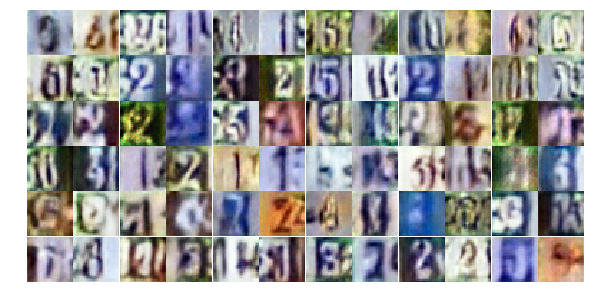

Epoch 8/25... Discriminator Loss: 0.5882... Generator Loss: 2.3750
Epoch 8/25... Discriminator Loss: 0.7032... Generator Loss: 1.0728
Epoch 8/25... Discriminator Loss: 0.6654... Generator Loss: 2.8065
Epoch 8/25... Discriminator Loss: 0.9250... Generator Loss: 0.8554
Epoch 8/25... Discriminator Loss: 0.4539... Generator Loss: 2.4351
Epoch 8/25... Discriminator Loss: 1.0827... Generator Loss: 0.6304
Epoch 8/25... Discriminator Loss: 0.6135... Generator Loss: 1.2204
Epoch 8/25... Discriminator Loss: 0.7561... Generator Loss: 2.3386
Epoch 9/25... Discriminator Loss: 0.9593... Generator Loss: 1.7896
Epoch 9/25... Discriminator Loss: 0.9289... Generator Loss: 0.7187


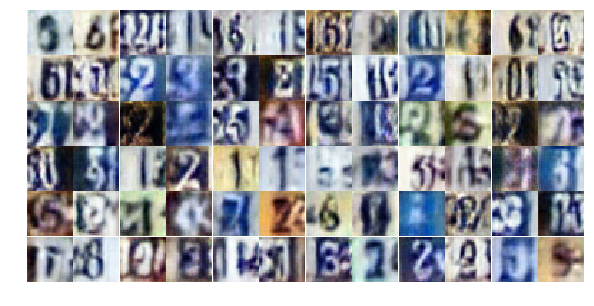

Epoch 9/25... Discriminator Loss: 0.8562... Generator Loss: 0.7868
Epoch 9/25... Discriminator Loss: 0.6582... Generator Loss: 1.0891
Epoch 9/25... Discriminator Loss: 1.0348... Generator Loss: 0.6117
Epoch 9/25... Discriminator Loss: 0.3525... Generator Loss: 2.1332
Epoch 9/25... Discriminator Loss: 1.2332... Generator Loss: 0.4929
Epoch 9/25... Discriminator Loss: 0.5069... Generator Loss: 1.4429
Epoch 9/25... Discriminator Loss: 0.7464... Generator Loss: 1.0481
Epoch 9/25... Discriminator Loss: 0.5462... Generator Loss: 1.3931
Epoch 9/25... Discriminator Loss: 1.0061... Generator Loss: 0.7057
Epoch 9/25... Discriminator Loss: 0.5872... Generator Loss: 1.3627


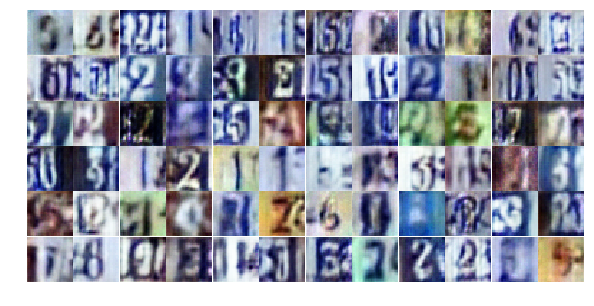

Epoch 9/25... Discriminator Loss: 0.7920... Generator Loss: 0.8340
Epoch 9/25... Discriminator Loss: 0.9965... Generator Loss: 0.6757
Epoch 9/25... Discriminator Loss: 0.7223... Generator Loss: 0.9794
Epoch 9/25... Discriminator Loss: 0.6808... Generator Loss: 0.9639
Epoch 9/25... Discriminator Loss: 0.5652... Generator Loss: 1.3742
Epoch 9/25... Discriminator Loss: 0.6618... Generator Loss: 1.6487
Epoch 9/25... Discriminator Loss: 1.4164... Generator Loss: 0.3878
Epoch 9/25... Discriminator Loss: 0.5342... Generator Loss: 1.2907
Epoch 9/25... Discriminator Loss: 1.1896... Generator Loss: 0.4921
Epoch 9/25... Discriminator Loss: 0.9468... Generator Loss: 0.6539


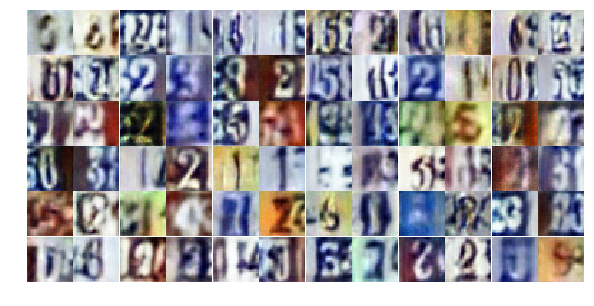

Epoch 9/25... Discriminator Loss: 1.0622... Generator Loss: 0.6641
Epoch 9/25... Discriminator Loss: 0.8218... Generator Loss: 0.8161
Epoch 9/25... Discriminator Loss: 0.5417... Generator Loss: 1.4080
Epoch 9/25... Discriminator Loss: 0.6113... Generator Loss: 1.1016
Epoch 9/25... Discriminator Loss: 0.5198... Generator Loss: 1.4115
Epoch 9/25... Discriminator Loss: 0.5412... Generator Loss: 1.2061
Epoch 9/25... Discriminator Loss: 0.9123... Generator Loss: 0.7728
Epoch 9/25... Discriminator Loss: 0.5896... Generator Loss: 1.2142
Epoch 9/25... Discriminator Loss: 0.5780... Generator Loss: 1.1443
Epoch 9/25... Discriminator Loss: 0.5675... Generator Loss: 1.1245


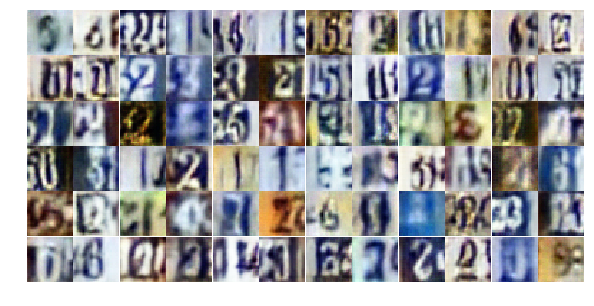

Epoch 9/25... Discriminator Loss: 0.4563... Generator Loss: 1.3953
Epoch 9/25... Discriminator Loss: 1.2156... Generator Loss: 0.4879
Epoch 9/25... Discriminator Loss: 1.2379... Generator Loss: 0.4855
Epoch 9/25... Discriminator Loss: 0.6086... Generator Loss: 1.1516
Epoch 9/25... Discriminator Loss: 0.5958... Generator Loss: 1.2644
Epoch 9/25... Discriminator Loss: 0.7316... Generator Loss: 1.6434
Epoch 9/25... Discriminator Loss: 0.4664... Generator Loss: 1.7103
Epoch 9/25... Discriminator Loss: 0.3815... Generator Loss: 1.7848
Epoch 9/25... Discriminator Loss: 0.6761... Generator Loss: 1.0245
Epoch 9/25... Discriminator Loss: 0.3729... Generator Loss: 1.5111


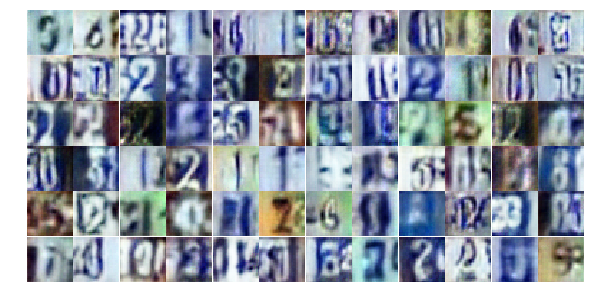

Epoch 9/25... Discriminator Loss: 0.3666... Generator Loss: 2.2033
Epoch 9/25... Discriminator Loss: 0.5663... Generator Loss: 1.3892
Epoch 9/25... Discriminator Loss: 2.1905... Generator Loss: 0.2395
Epoch 9/25... Discriminator Loss: 0.8615... Generator Loss: 3.0677
Epoch 9/25... Discriminator Loss: 0.5993... Generator Loss: 1.2294
Epoch 9/25... Discriminator Loss: 0.5922... Generator Loss: 1.4636
Epoch 9/25... Discriminator Loss: 0.8322... Generator Loss: 0.9837
Epoch 9/25... Discriminator Loss: 0.7184... Generator Loss: 0.9940
Epoch 9/25... Discriminator Loss: 0.5140... Generator Loss: 1.4291
Epoch 9/25... Discriminator Loss: 0.4137... Generator Loss: 2.4397


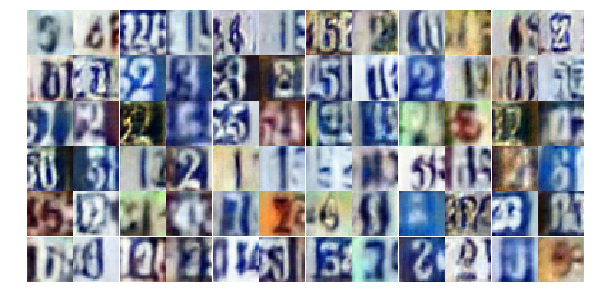

Epoch 9/25... Discriminator Loss: 0.9996... Generator Loss: 0.6798
Epoch 9/25... Discriminator Loss: 1.2293... Generator Loss: 3.5905
Epoch 9/25... Discriminator Loss: 0.6088... Generator Loss: 1.3636
Epoch 9/25... Discriminator Loss: 0.8765... Generator Loss: 0.7261
Epoch 9/25... Discriminator Loss: 0.4898... Generator Loss: 1.5504
Epoch 10/25... Discriminator Loss: 0.5495... Generator Loss: 1.3522
Epoch 10/25... Discriminator Loss: 0.7830... Generator Loss: 0.9125
Epoch 10/25... Discriminator Loss: 0.8102... Generator Loss: 0.8071
Epoch 10/25... Discriminator Loss: 0.7131... Generator Loss: 0.9773
Epoch 10/25... Discriminator Loss: 1.2702... Generator Loss: 0.4494


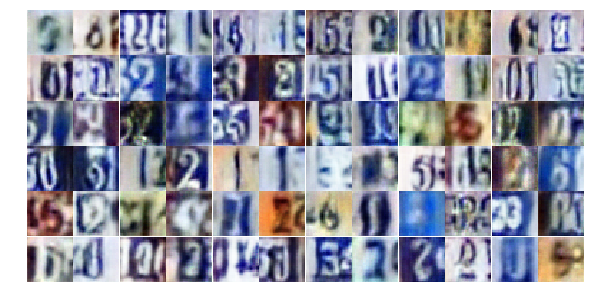

Epoch 10/25... Discriminator Loss: 1.3665... Generator Loss: 0.3879
Epoch 10/25... Discriminator Loss: 0.5816... Generator Loss: 1.5956
Epoch 10/25... Discriminator Loss: 0.7765... Generator Loss: 0.8554
Epoch 10/25... Discriminator Loss: 0.6998... Generator Loss: 0.9926
Epoch 10/25... Discriminator Loss: 0.6506... Generator Loss: 1.1905
Epoch 10/25... Discriminator Loss: 0.6210... Generator Loss: 1.2339
Epoch 10/25... Discriminator Loss: 0.5225... Generator Loss: 1.2931
Epoch 10/25... Discriminator Loss: 1.4923... Generator Loss: 0.3446
Epoch 10/25... Discriminator Loss: 0.7477... Generator Loss: 1.0426
Epoch 10/25... Discriminator Loss: 0.5654... Generator Loss: 1.8867


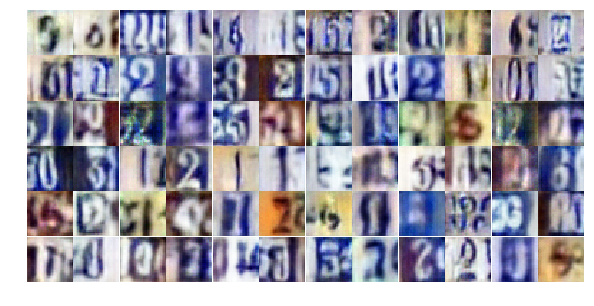

Epoch 10/25... Discriminator Loss: 1.3202... Generator Loss: 0.6267
Epoch 10/25... Discriminator Loss: 0.8704... Generator Loss: 0.8374
Epoch 10/25... Discriminator Loss: 0.5805... Generator Loss: 1.2683
Epoch 10/25... Discriminator Loss: 1.2944... Generator Loss: 0.4646
Epoch 10/25... Discriminator Loss: 0.5628... Generator Loss: 1.3084
Epoch 10/25... Discriminator Loss: 0.4313... Generator Loss: 1.5177
Epoch 10/25... Discriminator Loss: 0.5585... Generator Loss: 1.2060
Epoch 10/25... Discriminator Loss: 0.4405... Generator Loss: 1.6080
Epoch 10/25... Discriminator Loss: 0.6459... Generator Loss: 1.0695
Epoch 10/25... Discriminator Loss: 0.3370... Generator Loss: 2.6597


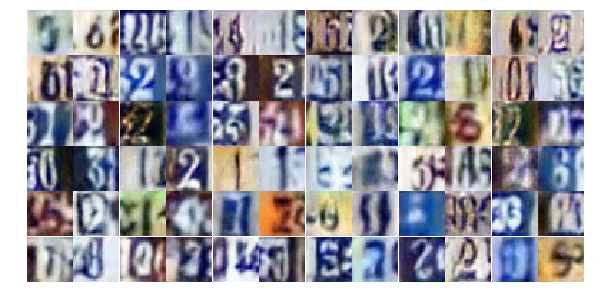

Epoch 10/25... Discriminator Loss: 1.4749... Generator Loss: 0.3369
Epoch 10/25... Discriminator Loss: 0.8006... Generator Loss: 0.9170
Epoch 10/25... Discriminator Loss: 0.4168... Generator Loss: 1.4847
Epoch 10/25... Discriminator Loss: 0.5651... Generator Loss: 2.6076
Epoch 10/25... Discriminator Loss: 1.2411... Generator Loss: 0.4519
Epoch 10/25... Discriminator Loss: 0.5032... Generator Loss: 1.4901
Epoch 10/25... Discriminator Loss: 0.4370... Generator Loss: 1.7904
Epoch 10/25... Discriminator Loss: 0.6267... Generator Loss: 1.2874
Epoch 10/25... Discriminator Loss: 0.8149... Generator Loss: 0.8499
Epoch 10/25... Discriminator Loss: 0.6505... Generator Loss: 1.1507


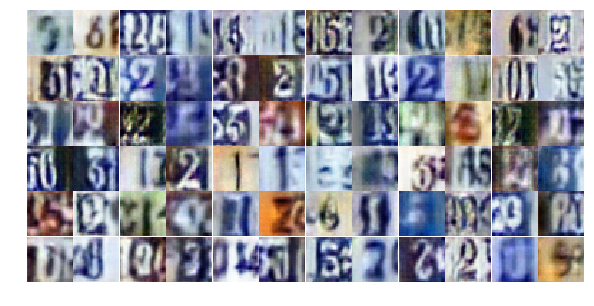

Epoch 10/25... Discriminator Loss: 0.5998... Generator Loss: 1.4770
Epoch 10/25... Discriminator Loss: 0.6480... Generator Loss: 1.0908
Epoch 10/25... Discriminator Loss: 0.4149... Generator Loss: 1.7458
Epoch 10/25... Discriminator Loss: 0.4737... Generator Loss: 1.7873
Epoch 10/25... Discriminator Loss: 0.7612... Generator Loss: 0.9175
Epoch 10/25... Discriminator Loss: 0.7328... Generator Loss: 0.8578
Epoch 10/25... Discriminator Loss: 0.5088... Generator Loss: 1.4793
Epoch 10/25... Discriminator Loss: 0.7730... Generator Loss: 0.8662
Epoch 10/25... Discriminator Loss: 0.3742... Generator Loss: 1.7059
Epoch 10/25... Discriminator Loss: 0.7138... Generator Loss: 3.1156


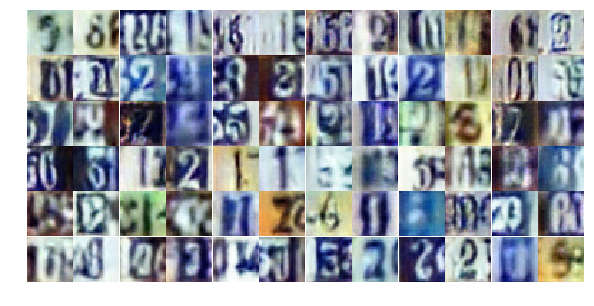

Epoch 10/25... Discriminator Loss: 1.5065... Generator Loss: 0.3828
Epoch 10/25... Discriminator Loss: 1.0630... Generator Loss: 1.8561
Epoch 10/25... Discriminator Loss: 0.6607... Generator Loss: 1.1666
Epoch 10/25... Discriminator Loss: 1.0995... Generator Loss: 0.5787
Epoch 10/25... Discriminator Loss: 0.6582... Generator Loss: 1.7863
Epoch 10/25... Discriminator Loss: 0.8039... Generator Loss: 0.8442
Epoch 10/25... Discriminator Loss: 0.4925... Generator Loss: 1.3326
Epoch 10/25... Discriminator Loss: 0.3193... Generator Loss: 1.9853
Epoch 10/25... Discriminator Loss: 0.5063... Generator Loss: 2.3430
Epoch 10/25... Discriminator Loss: 0.4560... Generator Loss: 1.4045


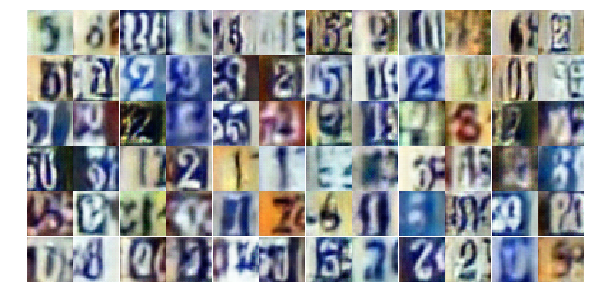

Epoch 10/25... Discriminator Loss: 0.8078... Generator Loss: 0.8791
Epoch 10/25... Discriminator Loss: 0.4137... Generator Loss: 1.5125
Epoch 10/25... Discriminator Loss: 0.6088... Generator Loss: 1.0847
Epoch 11/25... Discriminator Loss: 1.1062... Generator Loss: 0.5286
Epoch 11/25... Discriminator Loss: 0.3911... Generator Loss: 1.6631
Epoch 11/25... Discriminator Loss: 1.4327... Generator Loss: 0.3710
Epoch 11/25... Discriminator Loss: 0.7834... Generator Loss: 0.8935
Epoch 11/25... Discriminator Loss: 0.7111... Generator Loss: 1.1602
Epoch 11/25... Discriminator Loss: 1.9839... Generator Loss: 0.2206
Epoch 11/25... Discriminator Loss: 0.4794... Generator Loss: 1.7533


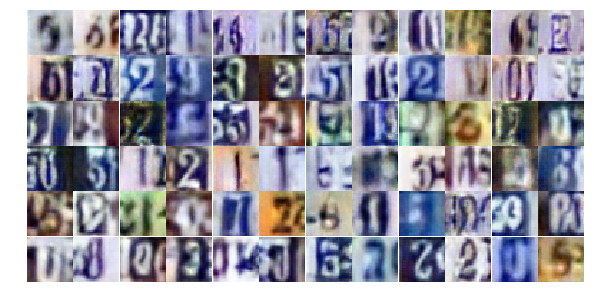

Epoch 11/25... Discriminator Loss: 0.3728... Generator Loss: 1.6994
Epoch 11/25... Discriminator Loss: 0.7567... Generator Loss: 0.8940
Epoch 11/25... Discriminator Loss: 0.4279... Generator Loss: 1.5306
Epoch 11/25... Discriminator Loss: 0.4914... Generator Loss: 1.3919
Epoch 11/25... Discriminator Loss: 0.8402... Generator Loss: 1.0006
Epoch 11/25... Discriminator Loss: 0.4093... Generator Loss: 1.5740
Epoch 11/25... Discriminator Loss: 0.5515... Generator Loss: 1.3892
Epoch 11/25... Discriminator Loss: 0.2793... Generator Loss: 2.3631
Epoch 11/25... Discriminator Loss: 0.9951... Generator Loss: 0.7183
Epoch 11/25... Discriminator Loss: 1.3309... Generator Loss: 0.4651


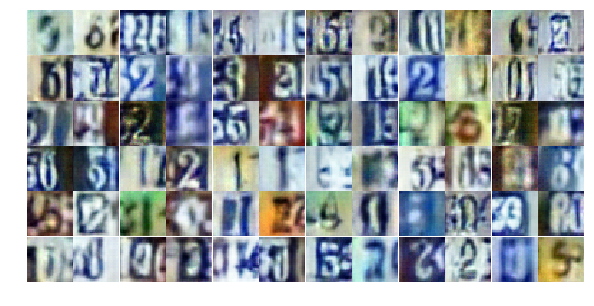

Epoch 11/25... Discriminator Loss: 0.7049... Generator Loss: 1.0485
Epoch 11/25... Discriminator Loss: 0.4508... Generator Loss: 1.7591
Epoch 11/25... Discriminator Loss: 0.7542... Generator Loss: 0.9020
Epoch 11/25... Discriminator Loss: 0.7159... Generator Loss: 0.9181
Epoch 11/25... Discriminator Loss: 0.4167... Generator Loss: 1.6858
Epoch 11/25... Discriminator Loss: 0.4664... Generator Loss: 1.6470
Epoch 11/25... Discriminator Loss: 0.5208... Generator Loss: 1.2397
Epoch 11/25... Discriminator Loss: 1.1978... Generator Loss: 0.4620
Epoch 11/25... Discriminator Loss: 0.7071... Generator Loss: 2.3295
Epoch 11/25... Discriminator Loss: 1.2520... Generator Loss: 0.4647


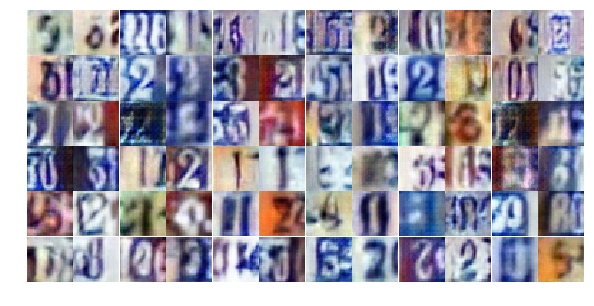

Epoch 11/25... Discriminator Loss: 0.6247... Generator Loss: 1.0811
Epoch 11/25... Discriminator Loss: 0.7362... Generator Loss: 0.9852
Epoch 11/25... Discriminator Loss: 0.7763... Generator Loss: 0.9847
Epoch 11/25... Discriminator Loss: 0.5682... Generator Loss: 1.0471
Epoch 11/25... Discriminator Loss: 0.7390... Generator Loss: 0.9016
Epoch 11/25... Discriminator Loss: 1.2485... Generator Loss: 0.4859
Epoch 11/25... Discriminator Loss: 1.5052... Generator Loss: 0.3525
Epoch 11/25... Discriminator Loss: 1.1483... Generator Loss: 1.1113
Epoch 11/25... Discriminator Loss: 0.7471... Generator Loss: 1.0824
Epoch 11/25... Discriminator Loss: 1.1380... Generator Loss: 0.5062


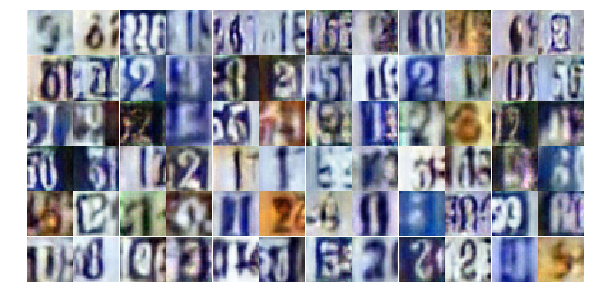

Epoch 11/25... Discriminator Loss: 0.5512... Generator Loss: 1.1954
Epoch 11/25... Discriminator Loss: 0.7158... Generator Loss: 0.9373
Epoch 11/25... Discriminator Loss: 1.2136... Generator Loss: 0.5068
Epoch 11/25... Discriminator Loss: 0.6814... Generator Loss: 1.0605
Epoch 11/25... Discriminator Loss: 0.7713... Generator Loss: 0.8542
Epoch 11/25... Discriminator Loss: 0.8940... Generator Loss: 0.8279
Epoch 11/25... Discriminator Loss: 0.3975... Generator Loss: 1.8252
Epoch 11/25... Discriminator Loss: 0.7260... Generator Loss: 1.5822
Epoch 11/25... Discriminator Loss: 1.1510... Generator Loss: 0.5479
Epoch 11/25... Discriminator Loss: 0.5298... Generator Loss: 1.4761


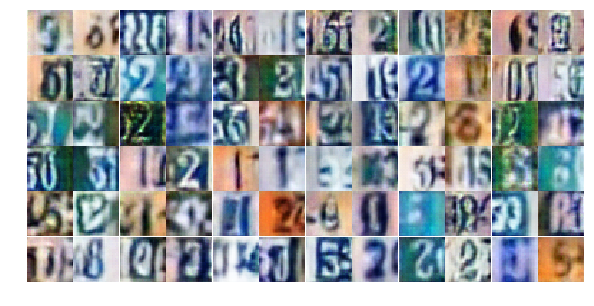

Epoch 11/25... Discriminator Loss: 0.8427... Generator Loss: 0.8144
Epoch 11/25... Discriminator Loss: 0.4153... Generator Loss: 1.6717
Epoch 11/25... Discriminator Loss: 0.5096... Generator Loss: 2.3290
Epoch 11/25... Discriminator Loss: 0.8879... Generator Loss: 0.7809
Epoch 11/25... Discriminator Loss: 1.0756... Generator Loss: 0.6166
Epoch 11/25... Discriminator Loss: 0.6595... Generator Loss: 1.1224
Epoch 11/25... Discriminator Loss: 1.2698... Generator Loss: 0.4667
Epoch 11/25... Discriminator Loss: 0.4395... Generator Loss: 1.7360
Epoch 11/25... Discriminator Loss: 0.9236... Generator Loss: 0.7021
Epoch 11/25... Discriminator Loss: 0.6338... Generator Loss: 1.0557


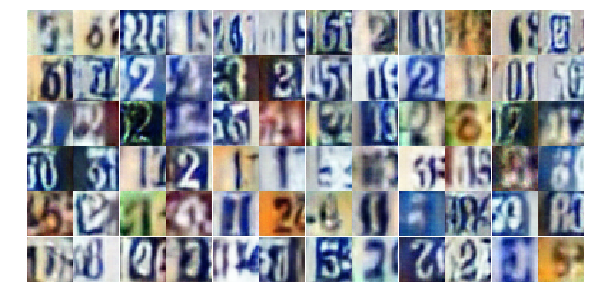

Epoch 12/25... Discriminator Loss: 0.6916... Generator Loss: 1.3569
Epoch 12/25... Discriminator Loss: 0.5704... Generator Loss: 1.2368
Epoch 12/25... Discriminator Loss: 1.3277... Generator Loss: 0.4370
Epoch 12/25... Discriminator Loss: 0.7495... Generator Loss: 1.0683
Epoch 12/25... Discriminator Loss: 0.3085... Generator Loss: 2.1078
Epoch 12/25... Discriminator Loss: 1.0890... Generator Loss: 0.6005
Epoch 12/25... Discriminator Loss: 0.4834... Generator Loss: 1.5170
Epoch 12/25... Discriminator Loss: 0.5101... Generator Loss: 1.5998
Epoch 12/25... Discriminator Loss: 0.7578... Generator Loss: 1.2068
Epoch 12/25... Discriminator Loss: 1.1123... Generator Loss: 0.5957


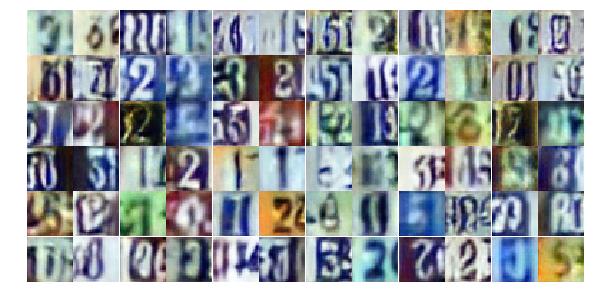

Epoch 12/25... Discriminator Loss: 0.4717... Generator Loss: 1.4638
Epoch 12/25... Discriminator Loss: 1.3914... Generator Loss: 0.4024
Epoch 12/25... Discriminator Loss: 0.4546... Generator Loss: 1.5402
Epoch 12/25... Discriminator Loss: 0.7838... Generator Loss: 2.1710
Epoch 12/25... Discriminator Loss: 0.5479... Generator Loss: 1.5734
Epoch 12/25... Discriminator Loss: 1.0459... Generator Loss: 0.7081
Epoch 12/25... Discriminator Loss: 1.4137... Generator Loss: 0.3813
Epoch 12/25... Discriminator Loss: 0.5826... Generator Loss: 2.3428
Epoch 12/25... Discriminator Loss: 0.5117... Generator Loss: 1.3618
Epoch 12/25... Discriminator Loss: 0.7335... Generator Loss: 0.9634


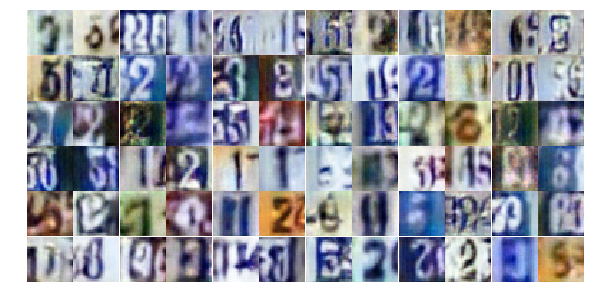

Epoch 12/25... Discriminator Loss: 0.4618... Generator Loss: 1.3568
Epoch 12/25... Discriminator Loss: 0.4965... Generator Loss: 2.4392
Epoch 12/25... Discriminator Loss: 0.8916... Generator Loss: 0.7266
Epoch 12/25... Discriminator Loss: 0.6261... Generator Loss: 3.3395
Epoch 12/25... Discriminator Loss: 0.3888... Generator Loss: 1.6630
Epoch 12/25... Discriminator Loss: 0.5442... Generator Loss: 1.2476
Epoch 12/25... Discriminator Loss: 0.5997... Generator Loss: 1.2366
Epoch 12/25... Discriminator Loss: 0.3347... Generator Loss: 1.8691
Epoch 12/25... Discriminator Loss: 0.3675... Generator Loss: 1.9231
Epoch 12/25... Discriminator Loss: 0.5921... Generator Loss: 1.2504


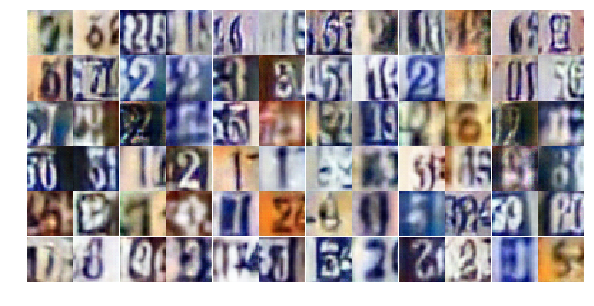

Epoch 12/25... Discriminator Loss: 0.6184... Generator Loss: 1.0629
Epoch 12/25... Discriminator Loss: 0.7562... Generator Loss: 0.9474
Epoch 12/25... Discriminator Loss: 0.6202... Generator Loss: 1.2528
Epoch 12/25... Discriminator Loss: 1.8492... Generator Loss: 0.2419
Epoch 12/25... Discriminator Loss: 0.6412... Generator Loss: 1.6637
Epoch 12/25... Discriminator Loss: 0.7564... Generator Loss: 1.1734
Epoch 12/25... Discriminator Loss: 0.9935... Generator Loss: 0.7622
Epoch 12/25... Discriminator Loss: 0.9508... Generator Loss: 0.8236
Epoch 12/25... Discriminator Loss: 0.4333... Generator Loss: 1.5674
Epoch 12/25... Discriminator Loss: 0.3281... Generator Loss: 1.8109


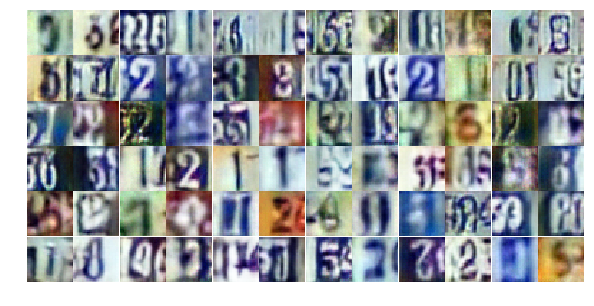

Epoch 12/25... Discriminator Loss: 0.6097... Generator Loss: 1.0736
Epoch 12/25... Discriminator Loss: 0.4781... Generator Loss: 1.9414
Epoch 12/25... Discriminator Loss: 0.4615... Generator Loss: 1.4260
Epoch 12/25... Discriminator Loss: 0.7388... Generator Loss: 1.0482
Epoch 12/25... Discriminator Loss: 3.7957... Generator Loss: 0.0464
Epoch 12/25... Discriminator Loss: 1.4012... Generator Loss: 0.4722
Epoch 12/25... Discriminator Loss: 0.7913... Generator Loss: 0.8975
Epoch 12/25... Discriminator Loss: 0.9567... Generator Loss: 0.8313
Epoch 12/25... Discriminator Loss: 0.6528... Generator Loss: 1.0800
Epoch 12/25... Discriminator Loss: 0.7906... Generator Loss: 0.8909


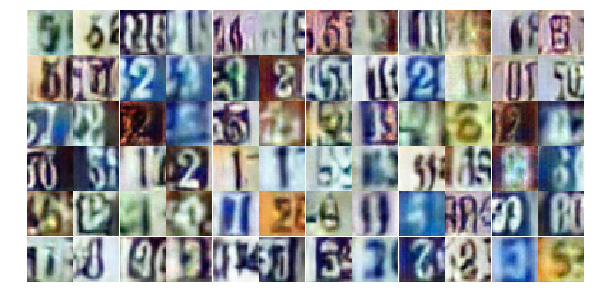

Epoch 12/25... Discriminator Loss: 0.8529... Generator Loss: 0.8313
Epoch 12/25... Discriminator Loss: 0.7743... Generator Loss: 0.9574
Epoch 12/25... Discriminator Loss: 0.7017... Generator Loss: 1.0319
Epoch 12/25... Discriminator Loss: 1.1411... Generator Loss: 0.5399
Epoch 12/25... Discriminator Loss: 0.5099... Generator Loss: 1.4012
Epoch 12/25... Discriminator Loss: 0.6792... Generator Loss: 1.8135
Epoch 12/25... Discriminator Loss: 0.6499... Generator Loss: 1.1693
Epoch 13/25... Discriminator Loss: 0.7523... Generator Loss: 1.0072
Epoch 13/25... Discriminator Loss: 0.5507... Generator Loss: 1.2218
Epoch 13/25... Discriminator Loss: 0.8159... Generator Loss: 0.8487


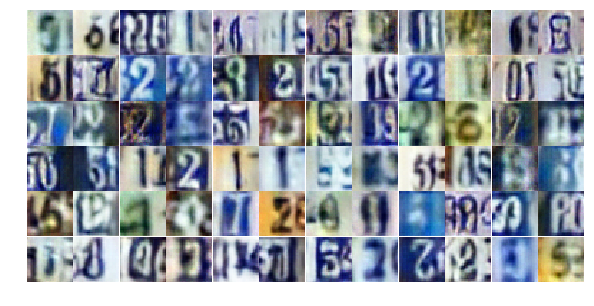

Epoch 13/25... Discriminator Loss: 0.8186... Generator Loss: 0.8106
Epoch 13/25... Discriminator Loss: 0.6242... Generator Loss: 1.1567
Epoch 13/25... Discriminator Loss: 0.8687... Generator Loss: 0.8599
Epoch 13/25... Discriminator Loss: 0.9830... Generator Loss: 0.6072
Epoch 13/25... Discriminator Loss: 0.4539... Generator Loss: 1.4998
Epoch 13/25... Discriminator Loss: 0.5962... Generator Loss: 1.2696
Epoch 13/25... Discriminator Loss: 0.4065... Generator Loss: 1.7058
Epoch 13/25... Discriminator Loss: 0.5693... Generator Loss: 1.2500
Epoch 13/25... Discriminator Loss: 0.4834... Generator Loss: 1.2998
Epoch 13/25... Discriminator Loss: 0.5360... Generator Loss: 1.4221


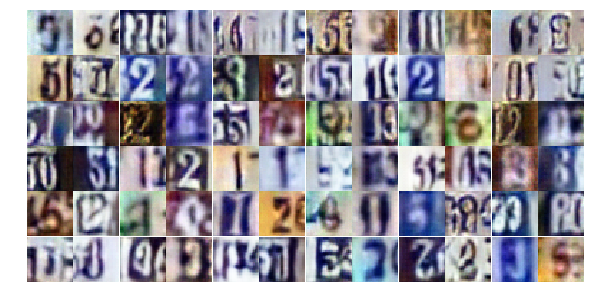

Epoch 13/25... Discriminator Loss: 1.1893... Generator Loss: 3.5502
Epoch 13/25... Discriminator Loss: 0.6722... Generator Loss: 1.0238
Epoch 13/25... Discriminator Loss: 0.9691... Generator Loss: 0.6744
Epoch 13/25... Discriminator Loss: 0.7695... Generator Loss: 1.0719
Epoch 13/25... Discriminator Loss: 0.6215... Generator Loss: 1.2354
Epoch 13/25... Discriminator Loss: 1.1435... Generator Loss: 0.5648
Epoch 13/25... Discriminator Loss: 0.7224... Generator Loss: 0.9813
Epoch 13/25... Discriminator Loss: 1.1660... Generator Loss: 0.5349
Epoch 13/25... Discriminator Loss: 0.6521... Generator Loss: 1.0807
Epoch 13/25... Discriminator Loss: 1.0519... Generator Loss: 0.5967


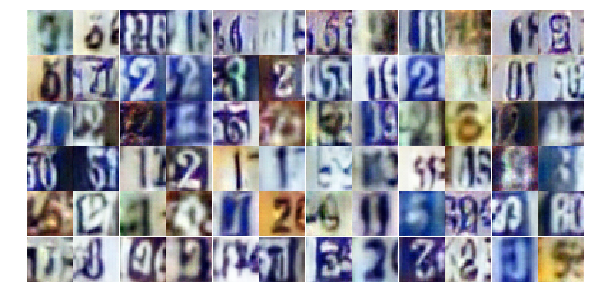

Epoch 13/25... Discriminator Loss: 0.7641... Generator Loss: 0.9400
Epoch 13/25... Discriminator Loss: 0.4380... Generator Loss: 1.5533
Epoch 13/25... Discriminator Loss: 0.7425... Generator Loss: 1.0155
Epoch 13/25... Discriminator Loss: 0.7751... Generator Loss: 0.9009
Epoch 13/25... Discriminator Loss: 0.7427... Generator Loss: 0.9017
Epoch 13/25... Discriminator Loss: 1.5967... Generator Loss: 0.3266
Epoch 13/25... Discriminator Loss: 0.9171... Generator Loss: 1.1936
Epoch 13/25... Discriminator Loss: 0.4511... Generator Loss: 1.5692
Epoch 13/25... Discriminator Loss: 0.6091... Generator Loss: 1.1000
Epoch 13/25... Discriminator Loss: 0.5900... Generator Loss: 1.3981


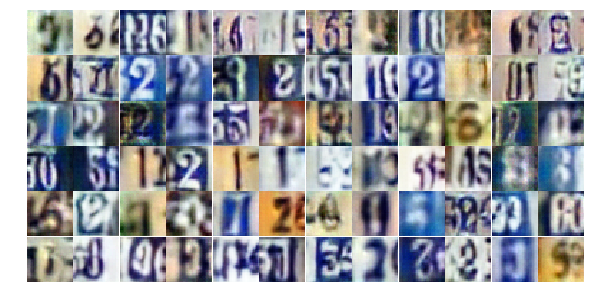

Epoch 13/25... Discriminator Loss: 0.8798... Generator Loss: 0.7979
Epoch 13/25... Discriminator Loss: 0.6415... Generator Loss: 1.5759
Epoch 13/25... Discriminator Loss: 0.7949... Generator Loss: 0.9236
Epoch 13/25... Discriminator Loss: 1.1024... Generator Loss: 0.5403
Epoch 13/25... Discriminator Loss: 0.6754... Generator Loss: 1.2952
Epoch 13/25... Discriminator Loss: 0.4658... Generator Loss: 1.6960
Epoch 13/25... Discriminator Loss: 0.4714... Generator Loss: 1.4484
Epoch 13/25... Discriminator Loss: 1.1584... Generator Loss: 0.5333
Epoch 13/25... Discriminator Loss: 0.5938... Generator Loss: 1.5453
Epoch 13/25... Discriminator Loss: 0.5262... Generator Loss: 1.4355


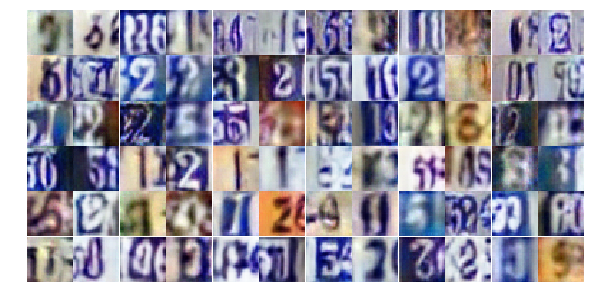

Epoch 13/25... Discriminator Loss: 0.5873... Generator Loss: 1.1916
Epoch 13/25... Discriminator Loss: 1.0338... Generator Loss: 0.6285
Epoch 13/25... Discriminator Loss: 0.8003... Generator Loss: 0.9011
Epoch 13/25... Discriminator Loss: 0.7644... Generator Loss: 0.8625
Epoch 13/25... Discriminator Loss: 0.9998... Generator Loss: 0.6471
Epoch 13/25... Discriminator Loss: 0.5988... Generator Loss: 1.2856
Epoch 13/25... Discriminator Loss: 0.5336... Generator Loss: 1.2584
Epoch 13/25... Discriminator Loss: 0.8112... Generator Loss: 0.7657
Epoch 13/25... Discriminator Loss: 0.9299... Generator Loss: 0.7140
Epoch 13/25... Discriminator Loss: 0.7331... Generator Loss: 0.9769


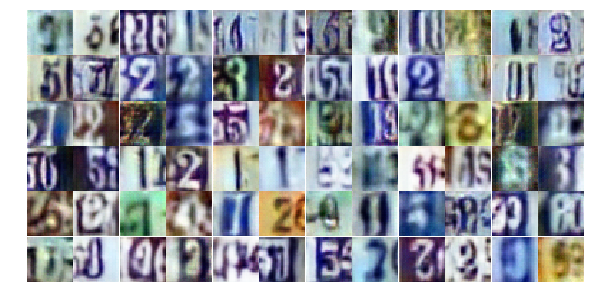

Epoch 13/25... Discriminator Loss: 0.3437... Generator Loss: 1.7256
Epoch 13/25... Discriminator Loss: 1.5769... Generator Loss: 0.3619
Epoch 13/25... Discriminator Loss: 0.7718... Generator Loss: 0.9063
Epoch 13/25... Discriminator Loss: 0.9074... Generator Loss: 0.7949
Epoch 14/25... Discriminator Loss: 1.3287... Generator Loss: 0.4449
Epoch 14/25... Discriminator Loss: 0.8484... Generator Loss: 0.8504
Epoch 14/25... Discriminator Loss: 0.7993... Generator Loss: 0.9652
Epoch 14/25... Discriminator Loss: 0.5875... Generator Loss: 2.1694
Epoch 14/25... Discriminator Loss: 0.5901... Generator Loss: 1.6672
Epoch 14/25... Discriminator Loss: 0.5458... Generator Loss: 1.2658


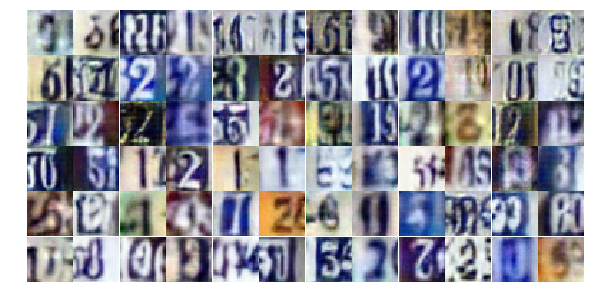

Epoch 14/25... Discriminator Loss: 0.7265... Generator Loss: 1.8985
Epoch 14/25... Discriminator Loss: 1.3988... Generator Loss: 4.5090
Epoch 14/25... Discriminator Loss: 1.1928... Generator Loss: 0.5300
Epoch 14/25... Discriminator Loss: 0.6465... Generator Loss: 1.2240
Epoch 14/25... Discriminator Loss: 0.9575... Generator Loss: 0.6430
Epoch 14/25... Discriminator Loss: 0.4840... Generator Loss: 1.2382
Epoch 14/25... Discriminator Loss: 0.4400... Generator Loss: 1.7292
Epoch 14/25... Discriminator Loss: 1.3248... Generator Loss: 0.4280
Epoch 14/25... Discriminator Loss: 1.3379... Generator Loss: 0.3885
Epoch 14/25... Discriminator Loss: 1.3684... Generator Loss: 0.4389


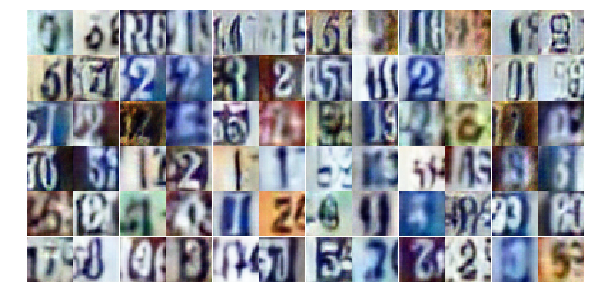

Epoch 14/25... Discriminator Loss: 0.8492... Generator Loss: 0.8328
Epoch 14/25... Discriminator Loss: 0.5773... Generator Loss: 1.6767
Epoch 14/25... Discriminator Loss: 1.0494... Generator Loss: 0.6030
Epoch 14/25... Discriminator Loss: 0.4524... Generator Loss: 1.8258
Epoch 14/25... Discriminator Loss: 0.7906... Generator Loss: 1.1833
Epoch 14/25... Discriminator Loss: 0.7139... Generator Loss: 1.1195
Epoch 14/25... Discriminator Loss: 0.9481... Generator Loss: 0.7369
Epoch 14/25... Discriminator Loss: 0.7706... Generator Loss: 0.9402
Epoch 14/25... Discriminator Loss: 0.6626... Generator Loss: 1.0882
Epoch 14/25... Discriminator Loss: 0.5523... Generator Loss: 1.1508


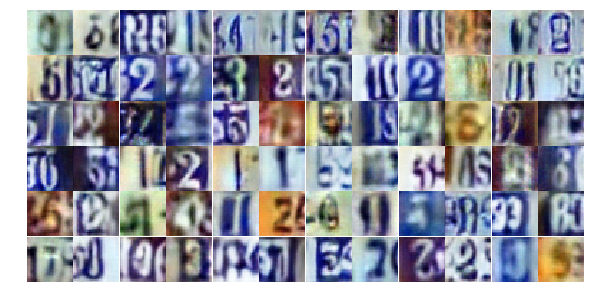

Epoch 14/25... Discriminator Loss: 1.3295... Generator Loss: 0.4304
Epoch 14/25... Discriminator Loss: 0.5518... Generator Loss: 1.2768
Epoch 14/25... Discriminator Loss: 0.5927... Generator Loss: 1.3762
Epoch 14/25... Discriminator Loss: 0.3570... Generator Loss: 1.6309
Epoch 14/25... Discriminator Loss: 0.8546... Generator Loss: 0.8075
Epoch 14/25... Discriminator Loss: 0.5512... Generator Loss: 1.2873
Epoch 14/25... Discriminator Loss: 0.7316... Generator Loss: 1.1234
Epoch 14/25... Discriminator Loss: 0.3689... Generator Loss: 2.2381
Epoch 14/25... Discriminator Loss: 0.5230... Generator Loss: 1.4417
Epoch 14/25... Discriminator Loss: 0.8733... Generator Loss: 0.7166


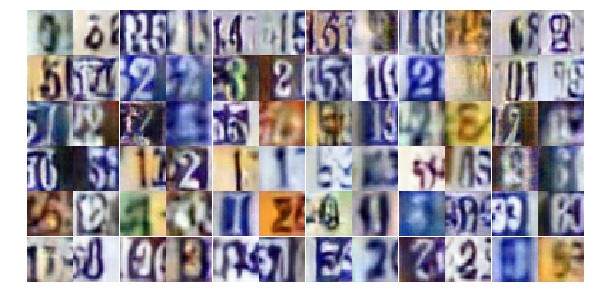

Epoch 14/25... Discriminator Loss: 1.1800... Generator Loss: 0.5170
Epoch 14/25... Discriminator Loss: 1.1705... Generator Loss: 2.8744
Epoch 14/25... Discriminator Loss: 0.7605... Generator Loss: 0.9190
Epoch 14/25... Discriminator Loss: 0.7573... Generator Loss: 0.9055
Epoch 14/25... Discriminator Loss: 0.8558... Generator Loss: 0.9006
Epoch 14/25... Discriminator Loss: 0.6606... Generator Loss: 1.0915
Epoch 14/25... Discriminator Loss: 0.6389... Generator Loss: 1.3769
Epoch 14/25... Discriminator Loss: 0.8310... Generator Loss: 0.8690
Epoch 14/25... Discriminator Loss: 1.2189... Generator Loss: 0.5085
Epoch 14/25... Discriminator Loss: 0.7738... Generator Loss: 1.4549


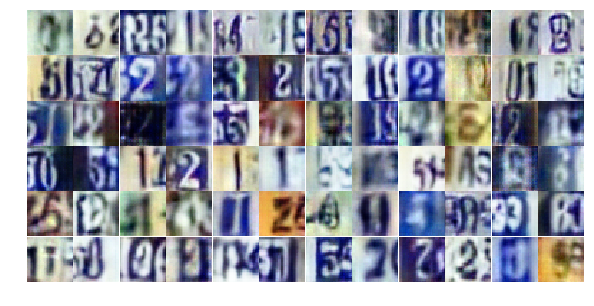

Epoch 14/25... Discriminator Loss: 1.1476... Generator Loss: 1.8237
Epoch 14/25... Discriminator Loss: 0.9965... Generator Loss: 0.6135
Epoch 14/25... Discriminator Loss: 0.5210... Generator Loss: 1.3912
Epoch 14/25... Discriminator Loss: 1.2171... Generator Loss: 0.4926
Epoch 14/25... Discriminator Loss: 0.6960... Generator Loss: 0.9499
Epoch 14/25... Discriminator Loss: 0.5159... Generator Loss: 1.3697
Epoch 14/25... Discriminator Loss: 0.6388... Generator Loss: 2.0026
Epoch 14/25... Discriminator Loss: 1.1915... Generator Loss: 0.4902
Epoch 14/25... Discriminator Loss: 0.8568... Generator Loss: 0.8322
Epoch 14/25... Discriminator Loss: 1.3600... Generator Loss: 0.4230


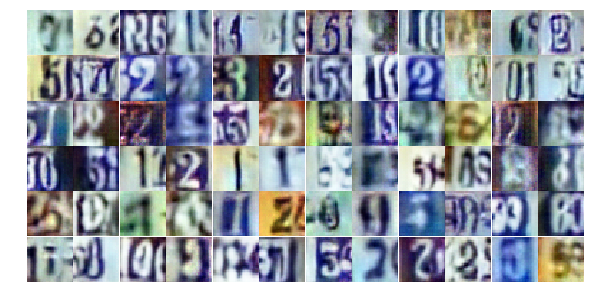

Epoch 14/25... Discriminator Loss: 0.7959... Generator Loss: 0.9237
Epoch 14/25... Discriminator Loss: 0.9147... Generator Loss: 0.7114
Epoch 15/25... Discriminator Loss: 1.0944... Generator Loss: 1.8731
Epoch 15/25... Discriminator Loss: 0.5854... Generator Loss: 1.5779
Epoch 15/25... Discriminator Loss: 0.5548... Generator Loss: 1.2360
Epoch 15/25... Discriminator Loss: 0.8995... Generator Loss: 0.7484
Epoch 15/25... Discriminator Loss: 0.9768... Generator Loss: 0.7481
Epoch 15/25... Discriminator Loss: 0.7133... Generator Loss: 0.8291
Epoch 15/25... Discriminator Loss: 0.9717... Generator Loss: 0.7831
Epoch 15/25... Discriminator Loss: 0.4416... Generator Loss: 1.3867


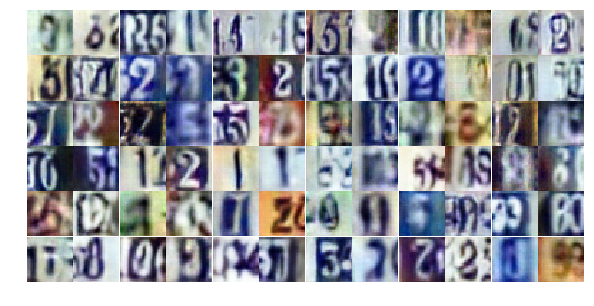

Epoch 15/25... Discriminator Loss: 0.7699... Generator Loss: 0.8864
Epoch 15/25... Discriminator Loss: 0.6759... Generator Loss: 1.8863
Epoch 15/25... Discriminator Loss: 0.8882... Generator Loss: 0.8062
Epoch 15/25... Discriminator Loss: 0.8432... Generator Loss: 0.8103
Epoch 15/25... Discriminator Loss: 0.8097... Generator Loss: 1.3778
Epoch 15/25... Discriminator Loss: 0.4942... Generator Loss: 1.4297
Epoch 15/25... Discriminator Loss: 1.8136... Generator Loss: 0.2720
Epoch 15/25... Discriminator Loss: 0.6993... Generator Loss: 1.9792
Epoch 15/25... Discriminator Loss: 0.5630... Generator Loss: 3.5533
Epoch 15/25... Discriminator Loss: 1.5206... Generator Loss: 0.4176


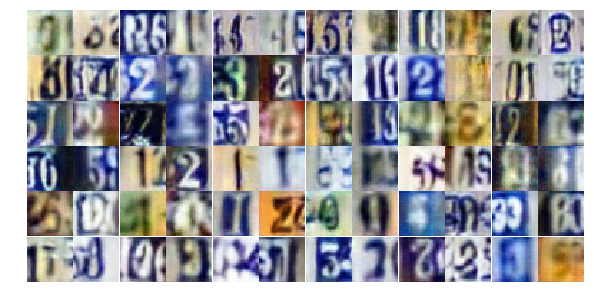

Epoch 15/25... Discriminator Loss: 1.1856... Generator Loss: 0.5559
Epoch 15/25... Discriminator Loss: 0.5580... Generator Loss: 1.5136
Epoch 15/25... Discriminator Loss: 0.5338... Generator Loss: 1.3885
Epoch 15/25... Discriminator Loss: 0.8364... Generator Loss: 0.8230
Epoch 15/25... Discriminator Loss: 0.8757... Generator Loss: 0.7547
Epoch 15/25... Discriminator Loss: 0.6716... Generator Loss: 1.0365
Epoch 15/25... Discriminator Loss: 0.9590... Generator Loss: 0.7865
Epoch 15/25... Discriminator Loss: 0.7341... Generator Loss: 0.9938
Epoch 15/25... Discriminator Loss: 0.6629... Generator Loss: 1.0048
Epoch 15/25... Discriminator Loss: 1.2051... Generator Loss: 0.5294


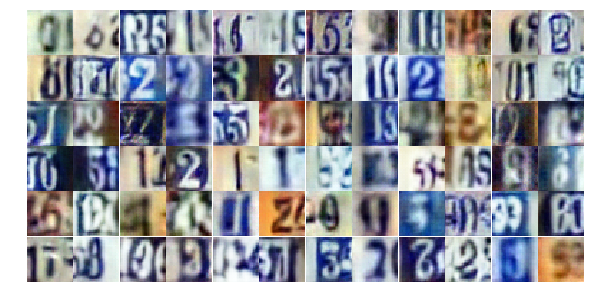

Epoch 15/25... Discriminator Loss: 1.1969... Generator Loss: 0.6409
Epoch 15/25... Discriminator Loss: 0.7429... Generator Loss: 0.9409
Epoch 15/25... Discriminator Loss: 0.4620... Generator Loss: 1.3391
Epoch 15/25... Discriminator Loss: 0.5665... Generator Loss: 1.2797
Epoch 15/25... Discriminator Loss: 0.6568... Generator Loss: 1.2463
Epoch 15/25... Discriminator Loss: 0.8203... Generator Loss: 2.0547
Epoch 15/25... Discriminator Loss: 0.4965... Generator Loss: 1.5393
Epoch 15/25... Discriminator Loss: 0.7215... Generator Loss: 0.9151
Epoch 15/25... Discriminator Loss: 0.6469... Generator Loss: 0.9596
Epoch 15/25... Discriminator Loss: 0.9636... Generator Loss: 0.6526


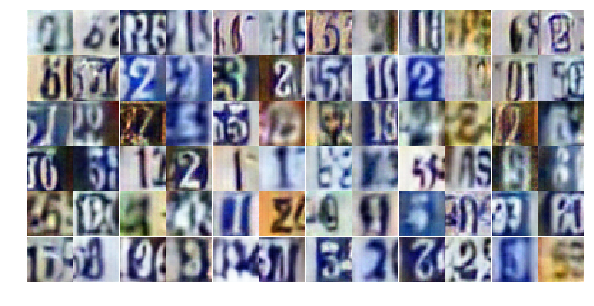

Epoch 15/25... Discriminator Loss: 0.6224... Generator Loss: 1.0783
Epoch 15/25... Discriminator Loss: 0.8395... Generator Loss: 0.7075
Epoch 15/25... Discriminator Loss: 0.5753... Generator Loss: 1.4534
Epoch 15/25... Discriminator Loss: 0.6844... Generator Loss: 0.9417
Epoch 15/25... Discriminator Loss: 0.6720... Generator Loss: 1.0055
Epoch 15/25... Discriminator Loss: 2.2799... Generator Loss: 0.1729
Epoch 15/25... Discriminator Loss: 0.7941... Generator Loss: 3.0411
Epoch 15/25... Discriminator Loss: 1.0166... Generator Loss: 1.2807
Epoch 15/25... Discriminator Loss: 0.8246... Generator Loss: 0.8464
Epoch 15/25... Discriminator Loss: 0.8597... Generator Loss: 1.2308


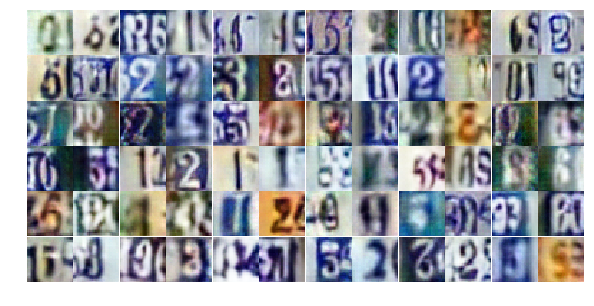

Epoch 15/25... Discriminator Loss: 1.1568... Generator Loss: 0.5470
Epoch 15/25... Discriminator Loss: 1.1923... Generator Loss: 0.5214
Epoch 15/25... Discriminator Loss: 0.6385... Generator Loss: 1.0067
Epoch 15/25... Discriminator Loss: 1.0569... Generator Loss: 0.6247
Epoch 15/25... Discriminator Loss: 0.5068... Generator Loss: 1.3313
Epoch 15/25... Discriminator Loss: 1.1887... Generator Loss: 0.5521
Epoch 15/25... Discriminator Loss: 1.0798... Generator Loss: 0.6510
Epoch 15/25... Discriminator Loss: 0.5246... Generator Loss: 1.3644
Epoch 15/25... Discriminator Loss: 1.3520... Generator Loss: 0.4370
Epoch 16/25... Discriminator Loss: 1.1734... Generator Loss: 0.5121


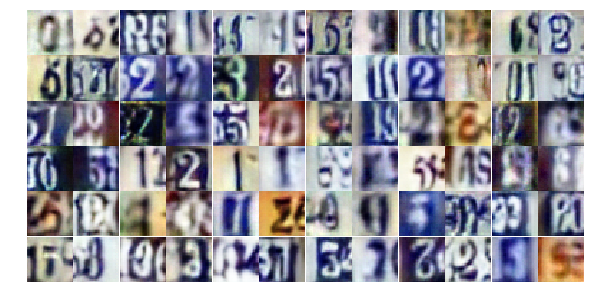

Epoch 16/25... Discriminator Loss: 0.5785... Generator Loss: 1.1572
Epoch 16/25... Discriminator Loss: 0.7323... Generator Loss: 1.0382
Epoch 16/25... Discriminator Loss: 1.0460... Generator Loss: 0.5723
Epoch 16/25... Discriminator Loss: 0.5783... Generator Loss: 1.4285
Epoch 16/25... Discriminator Loss: 0.5359... Generator Loss: 1.4581
Epoch 16/25... Discriminator Loss: 0.7492... Generator Loss: 1.0315
Epoch 16/25... Discriminator Loss: 1.5837... Generator Loss: 0.3378
Epoch 16/25... Discriminator Loss: 1.1843... Generator Loss: 0.4927
Epoch 16/25... Discriminator Loss: 0.5729... Generator Loss: 1.1438
Epoch 16/25... Discriminator Loss: 0.6809... Generator Loss: 1.0766


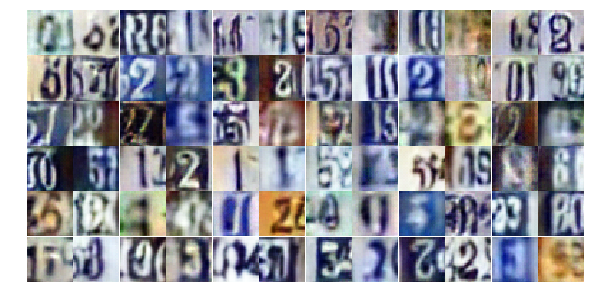

Epoch 16/25... Discriminator Loss: 2.0047... Generator Loss: 0.2180
Epoch 16/25... Discriminator Loss: 0.3765... Generator Loss: 1.7680
Epoch 16/25... Discriminator Loss: 0.7034... Generator Loss: 1.2198
Epoch 16/25... Discriminator Loss: 0.8908... Generator Loss: 0.7025
Epoch 16/25... Discriminator Loss: 0.4927... Generator Loss: 1.7316
Epoch 16/25... Discriminator Loss: 0.8399... Generator Loss: 0.8925
Epoch 16/25... Discriminator Loss: 1.4456... Generator Loss: 0.4583
Epoch 16/25... Discriminator Loss: 0.4626... Generator Loss: 1.7396
Epoch 16/25... Discriminator Loss: 0.5808... Generator Loss: 1.2711
Epoch 16/25... Discriminator Loss: 0.5752... Generator Loss: 1.2185


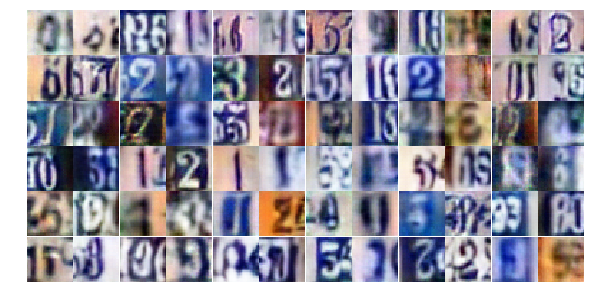

Epoch 16/25... Discriminator Loss: 0.8549... Generator Loss: 0.8375
Epoch 16/25... Discriminator Loss: 0.5984... Generator Loss: 1.1414
Epoch 16/25... Discriminator Loss: 0.6388... Generator Loss: 1.2115
Epoch 16/25... Discriminator Loss: 1.3401... Generator Loss: 0.4073
Epoch 16/25... Discriminator Loss: 0.8003... Generator Loss: 0.8994
Epoch 16/25... Discriminator Loss: 0.9066... Generator Loss: 0.7941
Epoch 16/25... Discriminator Loss: 0.8253... Generator Loss: 0.7905
Epoch 16/25... Discriminator Loss: 0.4881... Generator Loss: 1.4375
Epoch 16/25... Discriminator Loss: 3.9190... Generator Loss: 0.0624
Epoch 16/25... Discriminator Loss: 1.6595... Generator Loss: 0.3343


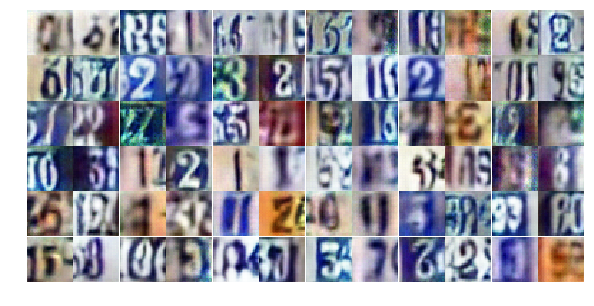

Epoch 16/25... Discriminator Loss: 1.6080... Generator Loss: 0.3266
Epoch 16/25... Discriminator Loss: 0.7160... Generator Loss: 0.9736
Epoch 16/25... Discriminator Loss: 0.6846... Generator Loss: 0.9479
Epoch 16/25... Discriminator Loss: 0.5313... Generator Loss: 1.3885
Epoch 16/25... Discriminator Loss: 1.2989... Generator Loss: 0.4745
Epoch 16/25... Discriminator Loss: 1.0561... Generator Loss: 0.5923
Epoch 16/25... Discriminator Loss: 0.7580... Generator Loss: 0.8942
Epoch 16/25... Discriminator Loss: 0.7557... Generator Loss: 0.8552
Epoch 16/25... Discriminator Loss: 0.8628... Generator Loss: 0.7926
Epoch 16/25... Discriminator Loss: 0.4144... Generator Loss: 1.8030


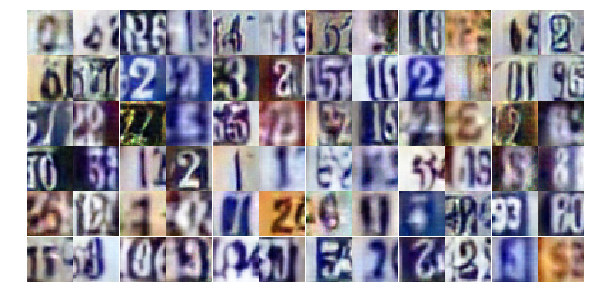

Epoch 16/25... Discriminator Loss: 0.4645... Generator Loss: 1.4457
Epoch 16/25... Discriminator Loss: 0.6265... Generator Loss: 1.2585
Epoch 16/25... Discriminator Loss: 0.8012... Generator Loss: 0.8625
Epoch 16/25... Discriminator Loss: 1.3554... Generator Loss: 0.4739
Epoch 16/25... Discriminator Loss: 0.6509... Generator Loss: 1.1162
Epoch 16/25... Discriminator Loss: 0.8064... Generator Loss: 0.8419
Epoch 16/25... Discriminator Loss: 0.5575... Generator Loss: 1.5449
Epoch 16/25... Discriminator Loss: 0.7679... Generator Loss: 0.8656
Epoch 16/25... Discriminator Loss: 0.5862... Generator Loss: 1.1054
Epoch 16/25... Discriminator Loss: 0.7993... Generator Loss: 0.8884


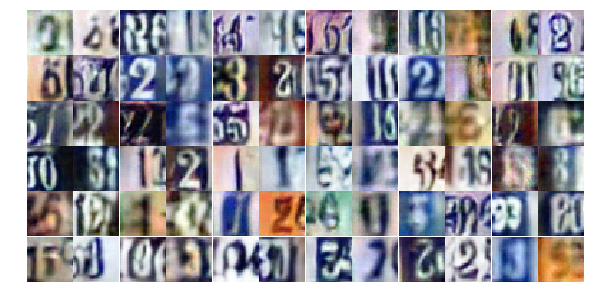

Epoch 16/25... Discriminator Loss: 0.8802... Generator Loss: 1.1409
Epoch 16/25... Discriminator Loss: 0.5332... Generator Loss: 1.3655
Epoch 16/25... Discriminator Loss: 3.2652... Generator Loss: 0.0723
Epoch 16/25... Discriminator Loss: 0.9161... Generator Loss: 1.2309
Epoch 16/25... Discriminator Loss: 0.6658... Generator Loss: 1.4836
Epoch 16/25... Discriminator Loss: 0.5591... Generator Loss: 1.4945
Epoch 17/25... Discriminator Loss: 0.6518... Generator Loss: 1.1429
Epoch 17/25... Discriminator Loss: 0.7345... Generator Loss: 0.9699
Epoch 17/25... Discriminator Loss: 0.6484... Generator Loss: 1.0529
Epoch 17/25... Discriminator Loss: 0.8427... Generator Loss: 0.8140


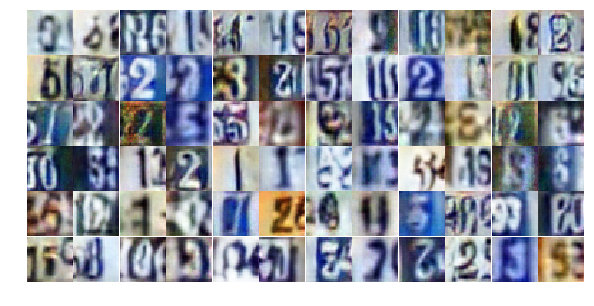

Epoch 17/25... Discriminator Loss: 0.5074... Generator Loss: 1.3960
Epoch 17/25... Discriminator Loss: 0.7079... Generator Loss: 0.9705
Epoch 17/25... Discriminator Loss: 0.8682... Generator Loss: 1.0257
Epoch 17/25... Discriminator Loss: 0.8190... Generator Loss: 0.8241
Epoch 17/25... Discriminator Loss: 1.1043... Generator Loss: 0.6107
Epoch 17/25... Discriminator Loss: 1.0931... Generator Loss: 0.6256
Epoch 17/25... Discriminator Loss: 0.7587... Generator Loss: 0.9865
Epoch 17/25... Discriminator Loss: 0.6202... Generator Loss: 1.1032
Epoch 17/25... Discriminator Loss: 0.3131... Generator Loss: 2.1162
Epoch 17/25... Discriminator Loss: 0.6773... Generator Loss: 1.3649


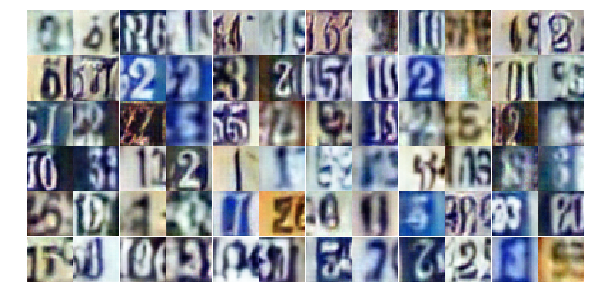

Epoch 17/25... Discriminator Loss: 0.8348... Generator Loss: 1.0227
Epoch 17/25... Discriminator Loss: 0.8907... Generator Loss: 0.7156
Epoch 17/25... Discriminator Loss: 0.6544... Generator Loss: 0.9971
Epoch 17/25... Discriminator Loss: 0.6323... Generator Loss: 1.5493
Epoch 17/25... Discriminator Loss: 0.4821... Generator Loss: 1.5670
Epoch 17/25... Discriminator Loss: 0.8524... Generator Loss: 0.7637
Epoch 17/25... Discriminator Loss: 0.6177... Generator Loss: 1.1756
Epoch 17/25... Discriminator Loss: 0.5664... Generator Loss: 1.3124
Epoch 17/25... Discriminator Loss: 0.6824... Generator Loss: 2.2560
Epoch 17/25... Discriminator Loss: 0.5847... Generator Loss: 1.1524


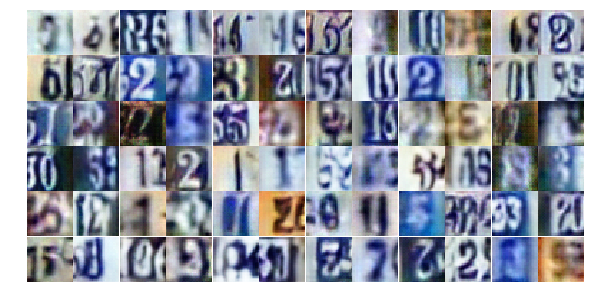

Epoch 17/25... Discriminator Loss: 1.6789... Generator Loss: 0.3294
Epoch 17/25... Discriminator Loss: 0.6090... Generator Loss: 1.3698
Epoch 17/25... Discriminator Loss: 0.5731... Generator Loss: 1.1788
Epoch 17/25... Discriminator Loss: 0.9466... Generator Loss: 0.6980
Epoch 17/25... Discriminator Loss: 1.7388... Generator Loss: 0.2829
Epoch 17/25... Discriminator Loss: 0.3635... Generator Loss: 1.7905
Epoch 17/25... Discriminator Loss: 1.0323... Generator Loss: 0.6353
Epoch 17/25... Discriminator Loss: 1.1902... Generator Loss: 0.5061
Epoch 17/25... Discriminator Loss: 0.9822... Generator Loss: 0.6844
Epoch 17/25... Discriminator Loss: 0.3905... Generator Loss: 1.8136


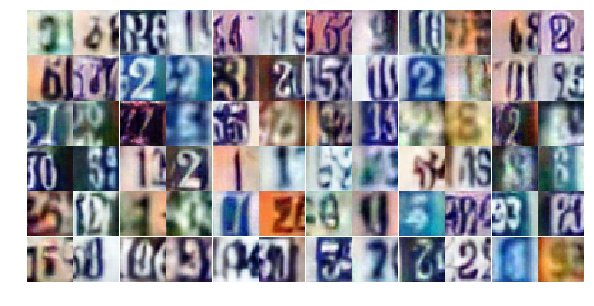

Epoch 17/25... Discriminator Loss: 0.6502... Generator Loss: 1.1322
Epoch 17/25... Discriminator Loss: 1.4698... Generator Loss: 0.3357
Epoch 17/25... Discriminator Loss: 0.6863... Generator Loss: 1.1875
Epoch 17/25... Discriminator Loss: 0.8697... Generator Loss: 1.8552
Epoch 17/25... Discriminator Loss: 1.0631... Generator Loss: 0.5853
Epoch 17/25... Discriminator Loss: 0.6102... Generator Loss: 1.3248
Epoch 17/25... Discriminator Loss: 0.7155... Generator Loss: 1.2365
Epoch 17/25... Discriminator Loss: 0.7378... Generator Loss: 0.9483
Epoch 17/25... Discriminator Loss: 0.4015... Generator Loss: 1.7294
Epoch 17/25... Discriminator Loss: 1.1285... Generator Loss: 0.5258


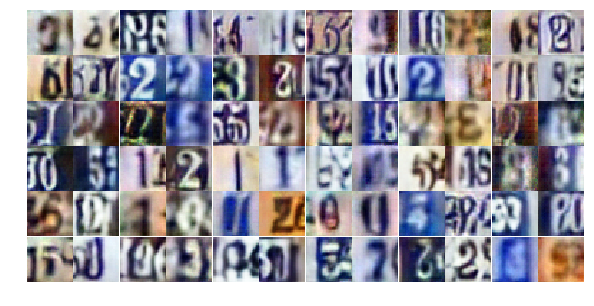

Epoch 17/25... Discriminator Loss: 1.6259... Generator Loss: 1.6584
Epoch 17/25... Discriminator Loss: 0.3171... Generator Loss: 1.9245
Epoch 17/25... Discriminator Loss: 0.6818... Generator Loss: 1.3702
Epoch 17/25... Discriminator Loss: 0.5374... Generator Loss: 1.1443
Epoch 17/25... Discriminator Loss: 0.8279... Generator Loss: 0.8208
Epoch 17/25... Discriminator Loss: 0.9495... Generator Loss: 0.7747
Epoch 17/25... Discriminator Loss: 1.1726... Generator Loss: 0.5368
Epoch 17/25... Discriminator Loss: 0.7571... Generator Loss: 0.9524
Epoch 17/25... Discriminator Loss: 1.1032... Generator Loss: 0.6407
Epoch 17/25... Discriminator Loss: 1.0980... Generator Loss: 0.6716


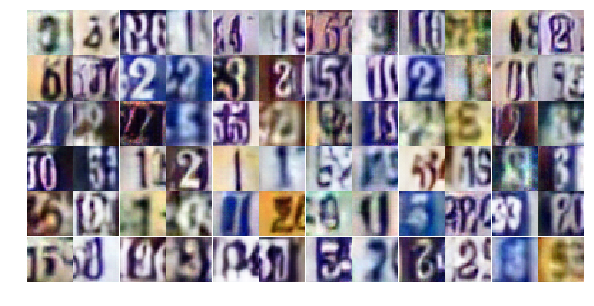

Epoch 17/25... Discriminator Loss: 0.7116... Generator Loss: 1.4609
Epoch 17/25... Discriminator Loss: 1.0083... Generator Loss: 1.4948
Epoch 17/25... Discriminator Loss: 0.5065... Generator Loss: 1.2522
Epoch 17/25... Discriminator Loss: 0.8645... Generator Loss: 0.7751
Epoch 18/25... Discriminator Loss: 1.0952... Generator Loss: 0.6211
Epoch 18/25... Discriminator Loss: 0.9060... Generator Loss: 0.7025
Epoch 18/25... Discriminator Loss: 0.6814... Generator Loss: 1.1001
Epoch 18/25... Discriminator Loss: 0.7090... Generator Loss: 0.9396
Epoch 18/25... Discriminator Loss: 1.0194... Generator Loss: 0.7026
Epoch 18/25... Discriminator Loss: 0.6497... Generator Loss: 1.1685


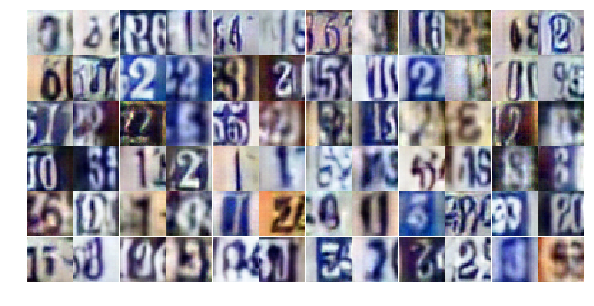

Epoch 18/25... Discriminator Loss: 0.3649... Generator Loss: 2.0039
Epoch 18/25... Discriminator Loss: 1.1413... Generator Loss: 0.5353
Epoch 18/25... Discriminator Loss: 0.8777... Generator Loss: 0.7583
Epoch 18/25... Discriminator Loss: 0.4049... Generator Loss: 1.6366
Epoch 18/25... Discriminator Loss: 0.7601... Generator Loss: 0.9467
Epoch 18/25... Discriminator Loss: 0.6783... Generator Loss: 1.0684
Epoch 18/25... Discriminator Loss: 0.5444... Generator Loss: 1.1349
Epoch 18/25... Discriminator Loss: 1.0374... Generator Loss: 0.6141
Epoch 18/25... Discriminator Loss: 0.8330... Generator Loss: 0.8246
Epoch 18/25... Discriminator Loss: 0.4028... Generator Loss: 1.7378


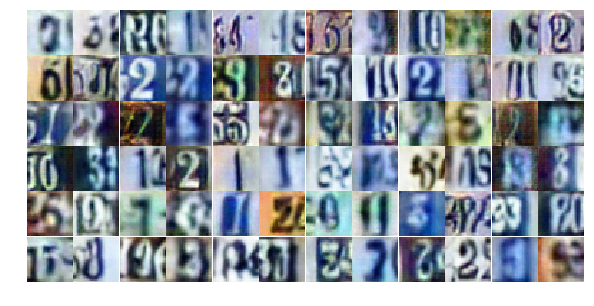

Epoch 18/25... Discriminator Loss: 1.5361... Generator Loss: 0.4431
Epoch 18/25... Discriminator Loss: 0.7000... Generator Loss: 1.9285
Epoch 18/25... Discriminator Loss: 0.9785... Generator Loss: 0.7130
Epoch 18/25... Discriminator Loss: 0.6404... Generator Loss: 1.1483
Epoch 18/25... Discriminator Loss: 0.6308... Generator Loss: 1.1093
Epoch 18/25... Discriminator Loss: 1.0448... Generator Loss: 0.6876
Epoch 18/25... Discriminator Loss: 0.6918... Generator Loss: 1.1714
Epoch 18/25... Discriminator Loss: 0.7683... Generator Loss: 0.9236
Epoch 18/25... Discriminator Loss: 0.8137... Generator Loss: 0.7849
Epoch 18/25... Discriminator Loss: 0.5542... Generator Loss: 1.8485


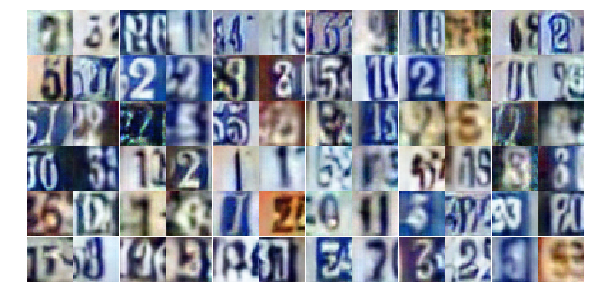

Epoch 18/25... Discriminator Loss: 0.4757... Generator Loss: 1.5672
Epoch 18/25... Discriminator Loss: 0.7797... Generator Loss: 0.8992
Epoch 18/25... Discriminator Loss: 0.5436... Generator Loss: 1.2553
Epoch 18/25... Discriminator Loss: 0.6586... Generator Loss: 1.2609
Epoch 18/25... Discriminator Loss: 1.1092... Generator Loss: 0.5874
Epoch 18/25... Discriminator Loss: 0.6700... Generator Loss: 1.0616
Epoch 18/25... Discriminator Loss: 0.8323... Generator Loss: 0.8142
Epoch 18/25... Discriminator Loss: 0.5009... Generator Loss: 1.3430
Epoch 18/25... Discriminator Loss: 0.5039... Generator Loss: 1.2668
Epoch 18/25... Discriminator Loss: 0.6956... Generator Loss: 0.9175


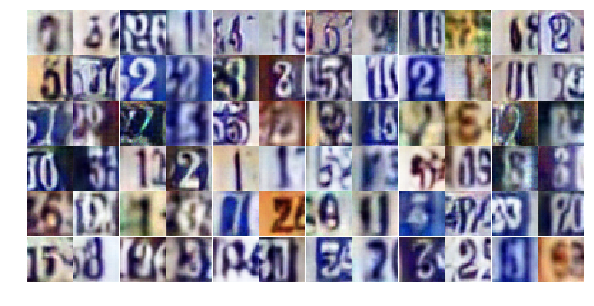

Epoch 18/25... Discriminator Loss: 0.7565... Generator Loss: 0.9158
Epoch 18/25... Discriminator Loss: 0.8067... Generator Loss: 1.0530
Epoch 18/25... Discriminator Loss: 0.5482... Generator Loss: 1.4137
Epoch 18/25... Discriminator Loss: 0.4953... Generator Loss: 1.8103
Epoch 18/25... Discriminator Loss: 0.9892... Generator Loss: 0.8504
Epoch 18/25... Discriminator Loss: 0.4936... Generator Loss: 1.3492
Epoch 18/25... Discriminator Loss: 0.9588... Generator Loss: 0.7199
Epoch 18/25... Discriminator Loss: 1.7450... Generator Loss: 3.1471
Epoch 18/25... Discriminator Loss: 0.9639... Generator Loss: 0.7544
Epoch 18/25... Discriminator Loss: 0.4606... Generator Loss: 1.6092


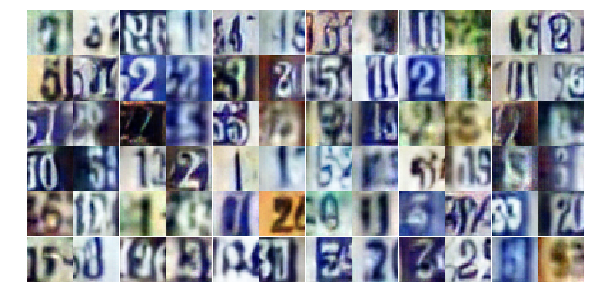

Epoch 18/25... Discriminator Loss: 0.5761... Generator Loss: 1.1517
Epoch 18/25... Discriminator Loss: 0.6554... Generator Loss: 1.1508
Epoch 18/25... Discriminator Loss: 0.7974... Generator Loss: 0.8901
Epoch 18/25... Discriminator Loss: 1.0808... Generator Loss: 0.5907
Epoch 18/25... Discriminator Loss: 0.6526... Generator Loss: 1.0102
Epoch 18/25... Discriminator Loss: 0.7887... Generator Loss: 0.9239
Epoch 18/25... Discriminator Loss: 0.8066... Generator Loss: 0.8495
Epoch 18/25... Discriminator Loss: 0.5207... Generator Loss: 1.3947
Epoch 18/25... Discriminator Loss: 0.9947... Generator Loss: 0.7243
Epoch 18/25... Discriminator Loss: 0.6945... Generator Loss: 0.9259


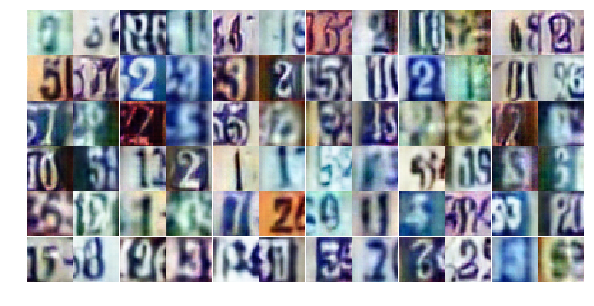

Epoch 18/25... Discriminator Loss: 1.0505... Generator Loss: 2.6024
Epoch 19/25... Discriminator Loss: 0.6816... Generator Loss: 1.2249
Epoch 19/25... Discriminator Loss: 1.2837... Generator Loss: 0.5399
Epoch 19/25... Discriminator Loss: 0.7685... Generator Loss: 1.5972
Epoch 19/25... Discriminator Loss: 0.6427... Generator Loss: 1.2416
Epoch 19/25... Discriminator Loss: 1.4381... Generator Loss: 0.4408
Epoch 19/25... Discriminator Loss: 0.8656... Generator Loss: 0.8279
Epoch 19/25... Discriminator Loss: 1.3282... Generator Loss: 0.4371
Epoch 19/25... Discriminator Loss: 0.6250... Generator Loss: 1.7631
Epoch 19/25... Discriminator Loss: 0.9147... Generator Loss: 0.7250


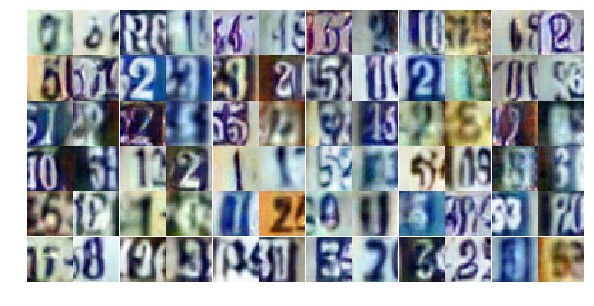

Epoch 19/25... Discriminator Loss: 0.8163... Generator Loss: 0.8265
Epoch 19/25... Discriminator Loss: 1.3651... Generator Loss: 0.4252
Epoch 19/25... Discriminator Loss: 1.2736... Generator Loss: 0.5117
Epoch 19/25... Discriminator Loss: 1.0617... Generator Loss: 0.5674
Epoch 19/25... Discriminator Loss: 1.2697... Generator Loss: 0.4951
Epoch 19/25... Discriminator Loss: 0.9997... Generator Loss: 0.6473
Epoch 19/25... Discriminator Loss: 1.1479... Generator Loss: 0.5631
Epoch 19/25... Discriminator Loss: 0.6350... Generator Loss: 1.1000
Epoch 19/25... Discriminator Loss: 3.4866... Generator Loss: 0.1188
Epoch 19/25... Discriminator Loss: 1.3387... Generator Loss: 0.6423


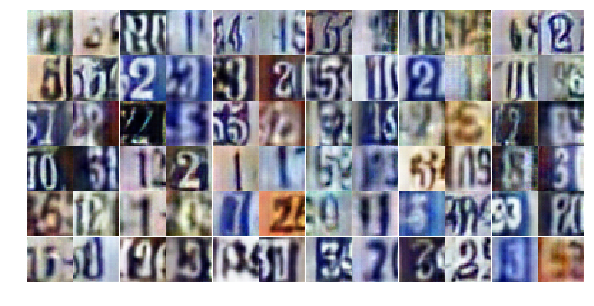

Epoch 19/25... Discriminator Loss: 1.0780... Generator Loss: 0.6968
Epoch 19/25... Discriminator Loss: 0.8863... Generator Loss: 1.2125
Epoch 19/25... Discriminator Loss: 1.1666... Generator Loss: 0.5533
Epoch 19/25... Discriminator Loss: 0.7822... Generator Loss: 0.8870
Epoch 19/25... Discriminator Loss: 1.1168... Generator Loss: 0.5730
Epoch 19/25... Discriminator Loss: 0.9115... Generator Loss: 0.7488
Epoch 19/25... Discriminator Loss: 0.9031... Generator Loss: 0.7723
Epoch 19/25... Discriminator Loss: 0.6632... Generator Loss: 1.0719
Epoch 19/25... Discriminator Loss: 0.8726... Generator Loss: 0.7460
Epoch 19/25... Discriminator Loss: 1.0464... Generator Loss: 0.6011


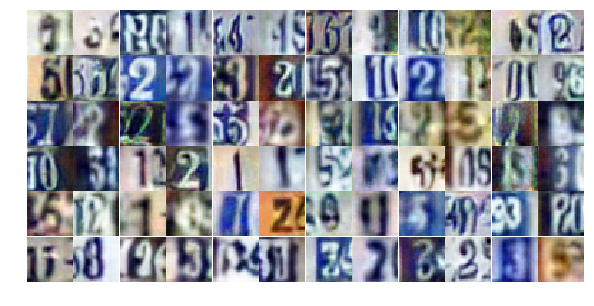

Epoch 19/25... Discriminator Loss: 1.2448... Generator Loss: 0.5694
Epoch 19/25... Discriminator Loss: 0.9495... Generator Loss: 0.6891
Epoch 19/25... Discriminator Loss: 1.0180... Generator Loss: 0.6514
Epoch 19/25... Discriminator Loss: 0.6093... Generator Loss: 1.1505
Epoch 19/25... Discriminator Loss: 0.7920... Generator Loss: 0.8989
Epoch 19/25... Discriminator Loss: 1.0962... Generator Loss: 0.5820
Epoch 19/25... Discriminator Loss: 0.7754... Generator Loss: 1.4485
Epoch 19/25... Discriminator Loss: 0.6504... Generator Loss: 1.0880
Epoch 19/25... Discriminator Loss: 0.9560... Generator Loss: 0.7457
Epoch 19/25... Discriminator Loss: 0.5345... Generator Loss: 1.4723


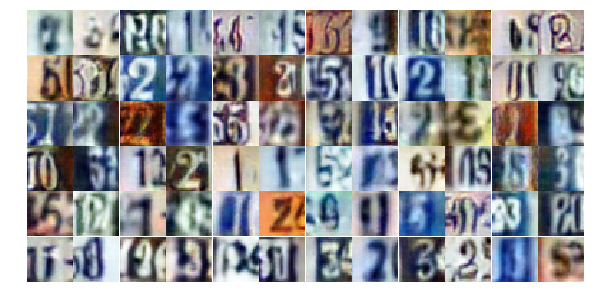

Epoch 19/25... Discriminator Loss: 0.5362... Generator Loss: 1.2374
Epoch 19/25... Discriminator Loss: 0.7888... Generator Loss: 0.9089
Epoch 19/25... Discriminator Loss: 0.7784... Generator Loss: 0.9325
Epoch 19/25... Discriminator Loss: 1.2319... Generator Loss: 0.5264
Epoch 19/25... Discriminator Loss: 0.8722... Generator Loss: 0.8918
Epoch 19/25... Discriminator Loss: 0.7052... Generator Loss: 0.9908
Epoch 19/25... Discriminator Loss: 0.5485... Generator Loss: 1.2494
Epoch 19/25... Discriminator Loss: 0.5191... Generator Loss: 1.5157
Epoch 19/25... Discriminator Loss: 0.5202... Generator Loss: 1.3618
Epoch 19/25... Discriminator Loss: 0.9081... Generator Loss: 0.7952


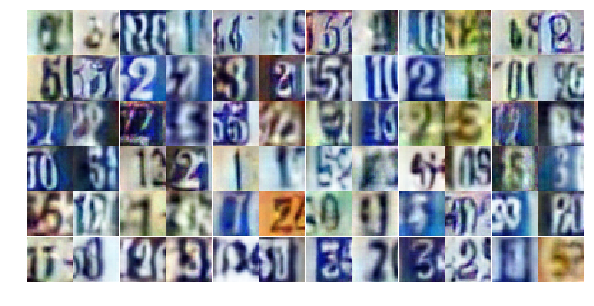

Epoch 19/25... Discriminator Loss: 1.0030... Generator Loss: 0.6056
Epoch 19/25... Discriminator Loss: 0.9838... Generator Loss: 0.6771
Epoch 19/25... Discriminator Loss: 0.6522... Generator Loss: 1.8654
Epoch 19/25... Discriminator Loss: 1.4385... Generator Loss: 0.3877
Epoch 19/25... Discriminator Loss: 0.9532... Generator Loss: 0.6849
Epoch 19/25... Discriminator Loss: 0.5787... Generator Loss: 1.4024
Epoch 19/25... Discriminator Loss: 1.9602... Generator Loss: 0.2210
Epoch 19/25... Discriminator Loss: 0.7783... Generator Loss: 0.9914
Epoch 20/25... Discriminator Loss: 0.9953... Generator Loss: 0.7070
Epoch 20/25... Discriminator Loss: 0.8352... Generator Loss: 0.9988


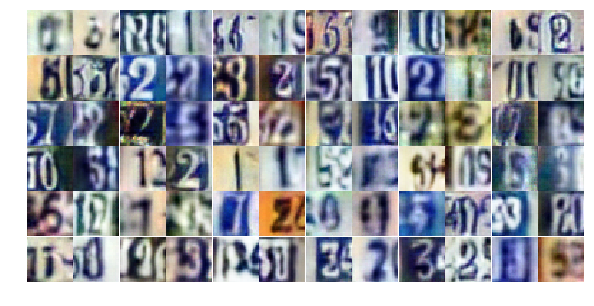

Epoch 20/25... Discriminator Loss: 0.5922... Generator Loss: 1.2003
Epoch 20/25... Discriminator Loss: 0.8664... Generator Loss: 0.8777
Epoch 20/25... Discriminator Loss: 1.4760... Generator Loss: 0.3856
Epoch 20/25... Discriminator Loss: 1.1496... Generator Loss: 0.5801
Epoch 20/25... Discriminator Loss: 0.5520... Generator Loss: 1.2523
Epoch 20/25... Discriminator Loss: 0.5634... Generator Loss: 1.2640
Epoch 20/25... Discriminator Loss: 0.5664... Generator Loss: 1.7235
Epoch 20/25... Discriminator Loss: 0.8255... Generator Loss: 0.8754
Epoch 20/25... Discriminator Loss: 0.6424... Generator Loss: 1.2078
Epoch 20/25... Discriminator Loss: 0.5768... Generator Loss: 1.1811


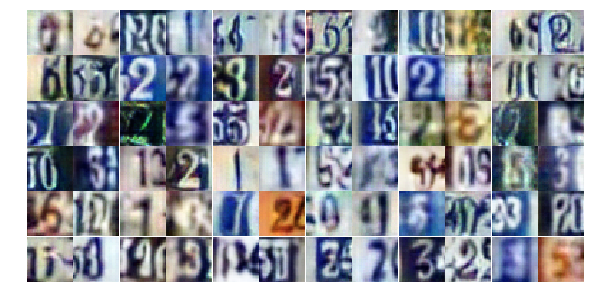

Epoch 20/25... Discriminator Loss: 1.0173... Generator Loss: 0.6505
Epoch 20/25... Discriminator Loss: 1.1414... Generator Loss: 0.6165
Epoch 20/25... Discriminator Loss: 0.6893... Generator Loss: 2.0766
Epoch 20/25... Discriminator Loss: 0.6062... Generator Loss: 1.1788
Epoch 20/25... Discriminator Loss: 0.9698... Generator Loss: 0.6950
Epoch 20/25... Discriminator Loss: 1.4636... Generator Loss: 0.4374
Epoch 20/25... Discriminator Loss: 0.9219... Generator Loss: 0.7698
Epoch 20/25... Discriminator Loss: 0.7105... Generator Loss: 0.9495
Epoch 20/25... Discriminator Loss: 0.8294... Generator Loss: 0.7988
Epoch 20/25... Discriminator Loss: 1.3158... Generator Loss: 0.5302


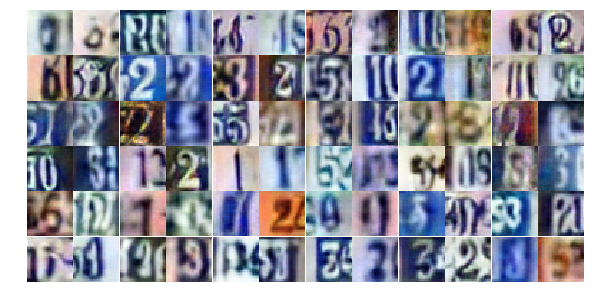

Epoch 20/25... Discriminator Loss: 0.5666... Generator Loss: 1.2957
Epoch 20/25... Discriminator Loss: 0.7904... Generator Loss: 0.8653
Epoch 20/25... Discriminator Loss: 0.3587... Generator Loss: 1.5723
Epoch 20/25... Discriminator Loss: 1.4007... Generator Loss: 0.4265
Epoch 20/25... Discriminator Loss: 0.9426... Generator Loss: 0.7944
Epoch 20/25... Discriminator Loss: 0.6204... Generator Loss: 1.0846
Epoch 20/25... Discriminator Loss: 0.5073... Generator Loss: 1.3980
Epoch 20/25... Discriminator Loss: 1.5053... Generator Loss: 0.4181
Epoch 20/25... Discriminator Loss: 1.0133... Generator Loss: 0.6918
Epoch 20/25... Discriminator Loss: 0.3779... Generator Loss: 1.7111


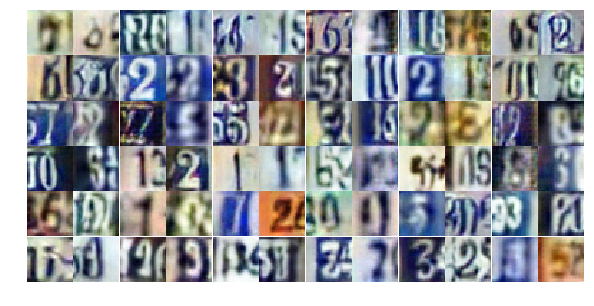

Epoch 20/25... Discriminator Loss: 0.7991... Generator Loss: 0.9267
Epoch 20/25... Discriminator Loss: 0.7071... Generator Loss: 0.9641
Epoch 20/25... Discriminator Loss: 1.0953... Generator Loss: 0.5682
Epoch 20/25... Discriminator Loss: 0.7735... Generator Loss: 1.2036
Epoch 20/25... Discriminator Loss: 0.8725... Generator Loss: 0.9079
Epoch 20/25... Discriminator Loss: 0.6503... Generator Loss: 1.0808
Epoch 20/25... Discriminator Loss: 1.1068... Generator Loss: 0.5967
Epoch 20/25... Discriminator Loss: 0.8379... Generator Loss: 0.8133
Epoch 20/25... Discriminator Loss: 0.7182... Generator Loss: 1.0247
Epoch 20/25... Discriminator Loss: 1.5045... Generator Loss: 0.4019


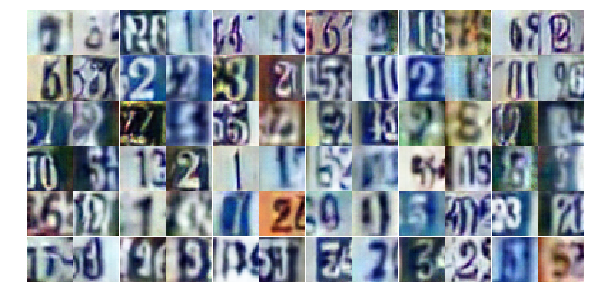

Epoch 20/25... Discriminator Loss: 1.9335... Generator Loss: 0.2444
Epoch 20/25... Discriminator Loss: 0.8619... Generator Loss: 0.9091
Epoch 20/25... Discriminator Loss: 1.3661... Generator Loss: 3.9674
Epoch 20/25... Discriminator Loss: 0.5951... Generator Loss: 1.2273
Epoch 20/25... Discriminator Loss: 0.7618... Generator Loss: 0.9610
Epoch 20/25... Discriminator Loss: 0.8635... Generator Loss: 0.8165
Epoch 20/25... Discriminator Loss: 0.8879... Generator Loss: 0.8629
Epoch 20/25... Discriminator Loss: 0.4463... Generator Loss: 1.4728
Epoch 20/25... Discriminator Loss: 0.6862... Generator Loss: 1.8714
Epoch 20/25... Discriminator Loss: 0.6483... Generator Loss: 1.2087


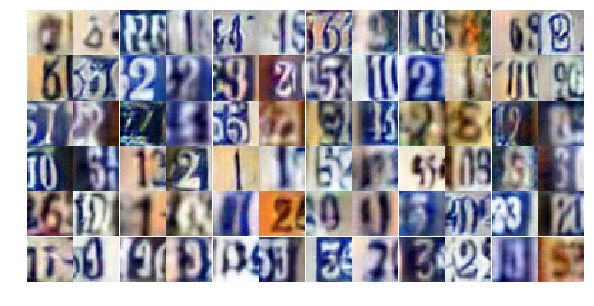

Epoch 20/25... Discriminator Loss: 0.5624... Generator Loss: 1.2348
Epoch 20/25... Discriminator Loss: 0.8665... Generator Loss: 0.8643
Epoch 20/25... Discriminator Loss: 0.5752... Generator Loss: 1.2395
Epoch 20/25... Discriminator Loss: 1.0952... Generator Loss: 0.6559
Epoch 20/25... Discriminator Loss: 0.6764... Generator Loss: 0.9842
Epoch 20/25... Discriminator Loss: 0.3975... Generator Loss: 1.8158
Epoch 21/25... Discriminator Loss: 1.1123... Generator Loss: 0.6271
Epoch 21/25... Discriminator Loss: 0.9421... Generator Loss: 0.7374
Epoch 21/25... Discriminator Loss: 1.0117... Generator Loss: 0.7700
Epoch 21/25... Discriminator Loss: 1.3465... Generator Loss: 0.4912


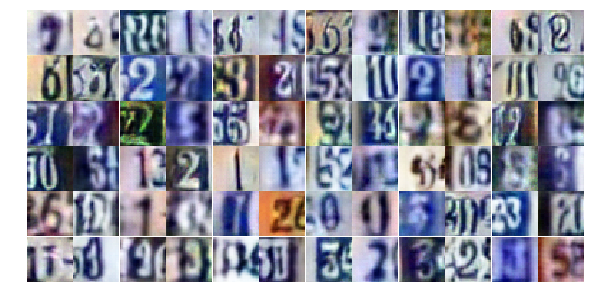

Epoch 21/25... Discriminator Loss: 1.0861... Generator Loss: 0.5917
Epoch 21/25... Discriminator Loss: 2.0090... Generator Loss: 0.2727
Epoch 21/25... Discriminator Loss: 1.4631... Generator Loss: 0.4991
Epoch 21/25... Discriminator Loss: 0.4933... Generator Loss: 1.2777
Epoch 21/25... Discriminator Loss: 0.9953... Generator Loss: 0.6849
Epoch 21/25... Discriminator Loss: 0.4509... Generator Loss: 1.5935
Epoch 21/25... Discriminator Loss: 0.8430... Generator Loss: 0.8868
Epoch 21/25... Discriminator Loss: 1.2406... Generator Loss: 0.5099
Epoch 21/25... Discriminator Loss: 0.7817... Generator Loss: 0.9195
Epoch 21/25... Discriminator Loss: 0.9686... Generator Loss: 0.6688


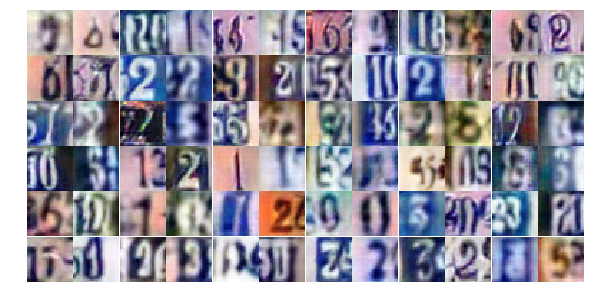

Epoch 21/25... Discriminator Loss: 0.2981... Generator Loss: 1.8810
Epoch 21/25... Discriminator Loss: 0.8091... Generator Loss: 0.9437
Epoch 21/25... Discriminator Loss: 2.1834... Generator Loss: 0.1756
Epoch 21/25... Discriminator Loss: 2.3374... Generator Loss: 0.2760
Epoch 21/25... Discriminator Loss: 0.6431... Generator Loss: 1.5749
Epoch 21/25... Discriminator Loss: 1.5994... Generator Loss: 0.3702
Epoch 21/25... Discriminator Loss: 0.9148... Generator Loss: 0.8199
Epoch 21/25... Discriminator Loss: 0.5163... Generator Loss: 1.6339
Epoch 21/25... Discriminator Loss: 0.5722... Generator Loss: 1.2433
Epoch 21/25... Discriminator Loss: 0.6538... Generator Loss: 1.1164


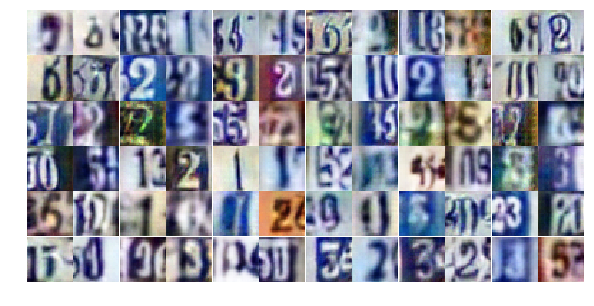

Epoch 21/25... Discriminator Loss: 1.2679... Generator Loss: 0.4728
Epoch 21/25... Discriminator Loss: 0.4232... Generator Loss: 1.5655
Epoch 21/25... Discriminator Loss: 1.0532... Generator Loss: 0.7018
Epoch 21/25... Discriminator Loss: 0.7531... Generator Loss: 0.9191
Epoch 21/25... Discriminator Loss: 1.1363... Generator Loss: 0.5142
Epoch 21/25... Discriminator Loss: 0.8062... Generator Loss: 1.2127
Epoch 21/25... Discriminator Loss: 0.7209... Generator Loss: 0.8785
Epoch 21/25... Discriminator Loss: 0.8445... Generator Loss: 0.8555
Epoch 21/25... Discriminator Loss: 1.1753... Generator Loss: 0.5237
Epoch 21/25... Discriminator Loss: 1.7253... Generator Loss: 0.3285


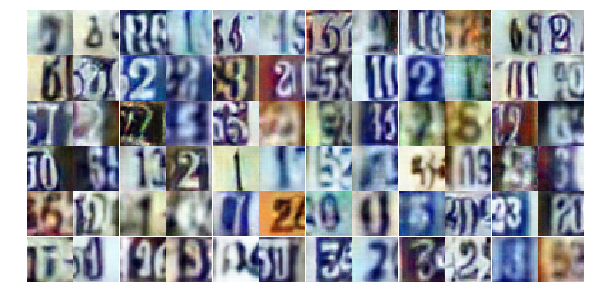

Epoch 21/25... Discriminator Loss: 1.1199... Generator Loss: 0.5902
Epoch 21/25... Discriminator Loss: 0.7392... Generator Loss: 0.9133
Epoch 21/25... Discriminator Loss: 1.2352... Generator Loss: 0.5407
Epoch 21/25... Discriminator Loss: 0.5067... Generator Loss: 1.3444
Epoch 21/25... Discriminator Loss: 0.6755... Generator Loss: 0.9718
Epoch 21/25... Discriminator Loss: 1.0727... Generator Loss: 0.6179
Epoch 21/25... Discriminator Loss: 0.7047... Generator Loss: 1.8132
Epoch 21/25... Discriminator Loss: 1.6981... Generator Loss: 0.2794
Epoch 21/25... Discriminator Loss: 0.8584... Generator Loss: 0.7873
Epoch 21/25... Discriminator Loss: 4.2326... Generator Loss: 0.0454


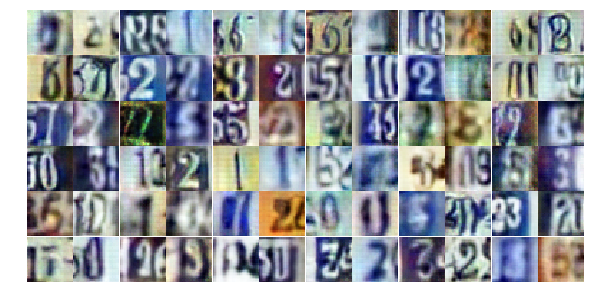

Epoch 21/25... Discriminator Loss: 1.0544... Generator Loss: 0.8833
Epoch 21/25... Discriminator Loss: 1.1028... Generator Loss: 0.6381
Epoch 21/25... Discriminator Loss: 0.7908... Generator Loss: 0.9215
Epoch 21/25... Discriminator Loss: 0.9803... Generator Loss: 0.8550
Epoch 21/25... Discriminator Loss: 0.4822... Generator Loss: 1.3701
Epoch 21/25... Discriminator Loss: 0.6647... Generator Loss: 1.3307
Epoch 21/25... Discriminator Loss: 0.9614... Generator Loss: 0.7612
Epoch 21/25... Discriminator Loss: 0.9530... Generator Loss: 0.8212
Epoch 21/25... Discriminator Loss: 0.9690... Generator Loss: 0.7010
Epoch 21/25... Discriminator Loss: 0.5910... Generator Loss: 1.2969


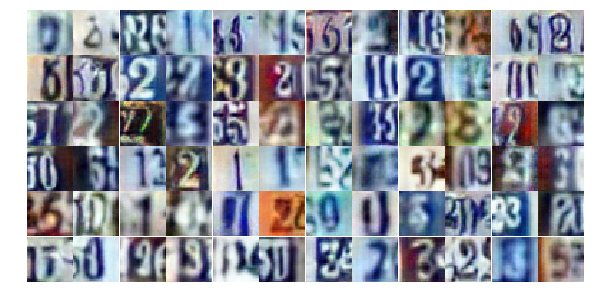

Epoch 21/25... Discriminator Loss: 0.6076... Generator Loss: 1.2576
Epoch 21/25... Discriminator Loss: 1.1413... Generator Loss: 0.5700
Epoch 21/25... Discriminator Loss: 0.8032... Generator Loss: 1.0708
Epoch 22/25... Discriminator Loss: 0.8236... Generator Loss: 1.8830
Epoch 22/25... Discriminator Loss: 1.0843... Generator Loss: 0.7855
Epoch 22/25... Discriminator Loss: 0.8174... Generator Loss: 0.9224
Epoch 22/25... Discriminator Loss: 0.5498... Generator Loss: 1.2277
Epoch 22/25... Discriminator Loss: 0.5477... Generator Loss: 1.2667
Epoch 22/25... Discriminator Loss: 1.1400... Generator Loss: 0.5877
Epoch 22/25... Discriminator Loss: 1.5532... Generator Loss: 0.3800


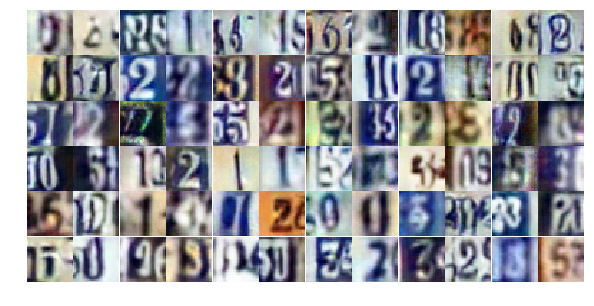

Epoch 22/25... Discriminator Loss: 0.6960... Generator Loss: 1.1497
Epoch 22/25... Discriminator Loss: 0.7743... Generator Loss: 1.0297
Epoch 22/25... Discriminator Loss: 1.1555... Generator Loss: 0.5668
Epoch 22/25... Discriminator Loss: 0.7754... Generator Loss: 0.9149
Epoch 22/25... Discriminator Loss: 0.8237... Generator Loss: 1.1796
Epoch 22/25... Discriminator Loss: 0.7000... Generator Loss: 1.0591
Epoch 22/25... Discriminator Loss: 0.6797... Generator Loss: 1.0488
Epoch 22/25... Discriminator Loss: 0.5158... Generator Loss: 1.9621
Epoch 22/25... Discriminator Loss: 0.7780... Generator Loss: 0.9266
Epoch 22/25... Discriminator Loss: 1.6045... Generator Loss: 0.3744


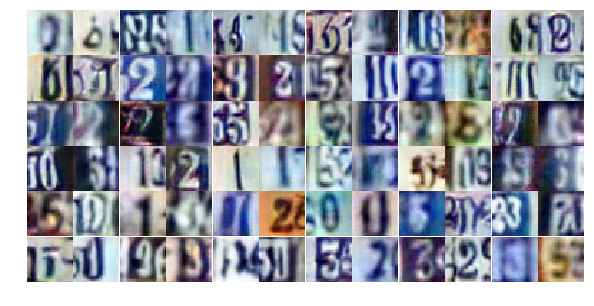

Epoch 22/25... Discriminator Loss: 0.5598... Generator Loss: 1.5675
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 1.0902
Epoch 22/25... Discriminator Loss: 0.8137... Generator Loss: 0.9069
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 0.9530
Epoch 22/25... Discriminator Loss: 0.4731... Generator Loss: 1.5807
Epoch 22/25... Discriminator Loss: 1.1748... Generator Loss: 0.5871
Epoch 22/25... Discriminator Loss: 0.4703... Generator Loss: 2.1913
Epoch 22/25... Discriminator Loss: 0.5881... Generator Loss: 1.3025
Epoch 22/25... Discriminator Loss: 0.4711... Generator Loss: 1.3324
Epoch 22/25... Discriminator Loss: 1.0598... Generator Loss: 0.5955


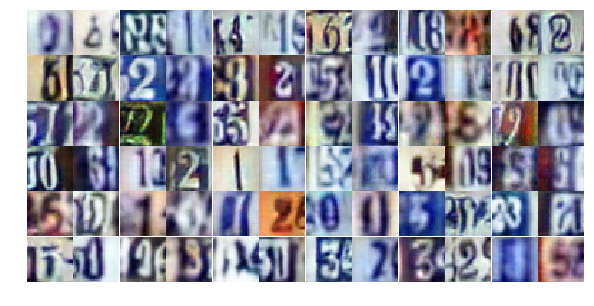

Epoch 22/25... Discriminator Loss: 0.3976... Generator Loss: 1.5558
Epoch 22/25... Discriminator Loss: 0.4853... Generator Loss: 1.8856
Epoch 22/25... Discriminator Loss: 0.7338... Generator Loss: 1.1407
Epoch 22/25... Discriminator Loss: 0.7696... Generator Loss: 0.8775
Epoch 22/25... Discriminator Loss: 0.7028... Generator Loss: 0.9195
Epoch 22/25... Discriminator Loss: 1.2368... Generator Loss: 0.5369
Epoch 22/25... Discriminator Loss: 1.2393... Generator Loss: 0.4950
Epoch 22/25... Discriminator Loss: 0.4759... Generator Loss: 1.8500
Epoch 22/25... Discriminator Loss: 0.7055... Generator Loss: 1.2256
Epoch 22/25... Discriminator Loss: 0.9796... Generator Loss: 0.7417


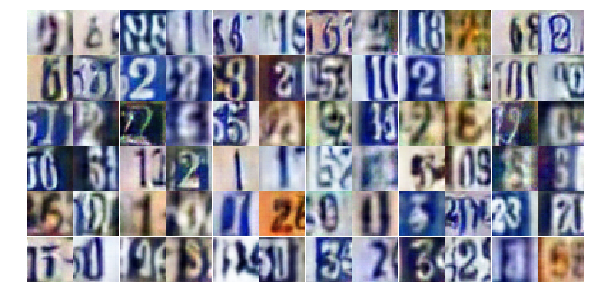

Epoch 22/25... Discriminator Loss: 1.1591... Generator Loss: 0.5410
Epoch 22/25... Discriminator Loss: 0.8269... Generator Loss: 0.8411
Epoch 22/25... Discriminator Loss: 0.4310... Generator Loss: 1.4583
Epoch 22/25... Discriminator Loss: 1.2134... Generator Loss: 0.4944
Epoch 22/25... Discriminator Loss: 0.4091... Generator Loss: 1.7000
Epoch 22/25... Discriminator Loss: 0.6306... Generator Loss: 1.1090
Epoch 22/25... Discriminator Loss: 0.4355... Generator Loss: 1.6513
Epoch 22/25... Discriminator Loss: 1.2013... Generator Loss: 0.5145
Epoch 22/25... Discriminator Loss: 0.9190... Generator Loss: 0.7739
Epoch 22/25... Discriminator Loss: 0.8812... Generator Loss: 0.7855


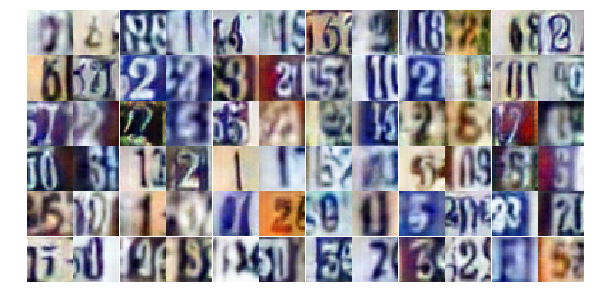

Epoch 22/25... Discriminator Loss: 1.1481... Generator Loss: 0.6003
Epoch 22/25... Discriminator Loss: 0.5916... Generator Loss: 1.5481
Epoch 22/25... Discriminator Loss: 1.2769... Generator Loss: 0.4776
Epoch 22/25... Discriminator Loss: 0.9293... Generator Loss: 0.7709
Epoch 22/25... Discriminator Loss: 0.7623... Generator Loss: 0.9743
Epoch 22/25... Discriminator Loss: 0.7689... Generator Loss: 0.9895
Epoch 22/25... Discriminator Loss: 0.6372... Generator Loss: 1.4575
Epoch 22/25... Discriminator Loss: 0.4907... Generator Loss: 1.3274
Epoch 22/25... Discriminator Loss: 0.7057... Generator Loss: 1.8050
Epoch 22/25... Discriminator Loss: 0.5328... Generator Loss: 1.2937


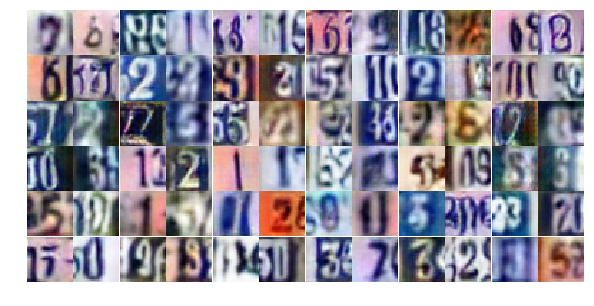

Epoch 23/25... Discriminator Loss: 0.4603... Generator Loss: 1.5290
Epoch 23/25... Discriminator Loss: 0.4403... Generator Loss: 1.4876
Epoch 23/25... Discriminator Loss: 0.8163... Generator Loss: 0.8245
Epoch 23/25... Discriminator Loss: 0.4937... Generator Loss: 1.4234
Epoch 23/25... Discriminator Loss: 0.7613... Generator Loss: 0.8967
Epoch 23/25... Discriminator Loss: 1.1848... Generator Loss: 0.5396
Epoch 23/25... Discriminator Loss: 1.0765... Generator Loss: 0.6106
Epoch 23/25... Discriminator Loss: 0.8997... Generator Loss: 0.9402
Epoch 23/25... Discriminator Loss: 1.0019... Generator Loss: 0.7311
Epoch 23/25... Discriminator Loss: 0.5371... Generator Loss: 1.4014


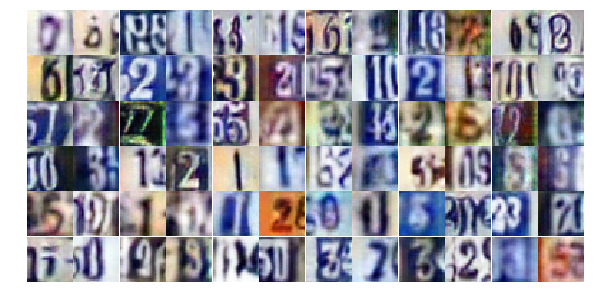

Epoch 23/25... Discriminator Loss: 0.4577... Generator Loss: 1.5281
Epoch 23/25... Discriminator Loss: 0.7338... Generator Loss: 0.9248
Epoch 23/25... Discriminator Loss: 0.6258... Generator Loss: 1.2236
Epoch 23/25... Discriminator Loss: 0.6375... Generator Loss: 1.1081
Epoch 23/25... Discriminator Loss: 0.6347... Generator Loss: 1.1012
Epoch 23/25... Discriminator Loss: 1.2993... Generator Loss: 0.4679
Epoch 23/25... Discriminator Loss: 0.9397... Generator Loss: 0.7614
Epoch 23/25... Discriminator Loss: 0.9788... Generator Loss: 2.3975
Epoch 23/25... Discriminator Loss: 1.0340... Generator Loss: 0.6599
Epoch 23/25... Discriminator Loss: 0.7040... Generator Loss: 1.4398


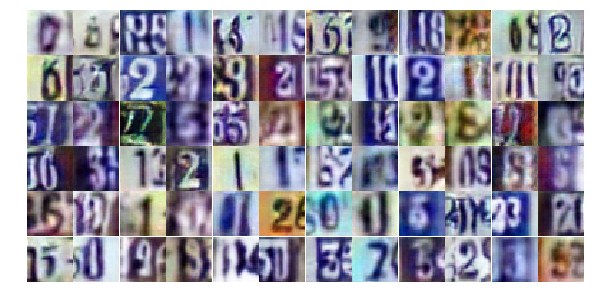

Epoch 23/25... Discriminator Loss: 0.8423... Generator Loss: 0.8150
Epoch 23/25... Discriminator Loss: 0.5638... Generator Loss: 2.2984
Epoch 23/25... Discriminator Loss: 1.3800... Generator Loss: 0.4256
Epoch 23/25... Discriminator Loss: 0.8240... Generator Loss: 0.7977
Epoch 23/25... Discriminator Loss: 0.4552... Generator Loss: 1.7644
Epoch 23/25... Discriminator Loss: 0.5624... Generator Loss: 2.0448
Epoch 23/25... Discriminator Loss: 0.5521... Generator Loss: 2.0782
Epoch 23/25... Discriminator Loss: 0.7257... Generator Loss: 1.0960
Epoch 23/25... Discriminator Loss: 0.9810... Generator Loss: 0.7185
Epoch 23/25... Discriminator Loss: 0.7451... Generator Loss: 1.4466


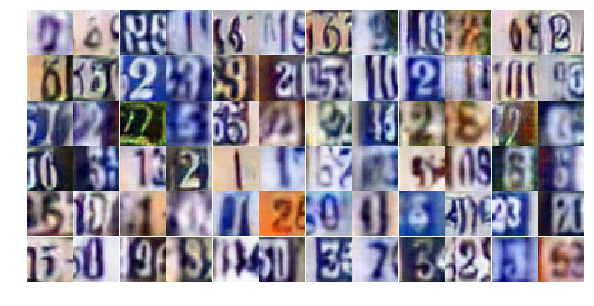

Epoch 23/25... Discriminator Loss: 0.4956... Generator Loss: 1.2750
Epoch 23/25... Discriminator Loss: 0.6670... Generator Loss: 1.0345
Epoch 23/25... Discriminator Loss: 0.7632... Generator Loss: 0.9632
Epoch 23/25... Discriminator Loss: 1.2180... Generator Loss: 0.4661
Epoch 23/25... Discriminator Loss: 0.6429... Generator Loss: 1.5220
Epoch 23/25... Discriminator Loss: 0.7052... Generator Loss: 1.4183
Epoch 23/25... Discriminator Loss: 1.2054... Generator Loss: 0.5422
Epoch 23/25... Discriminator Loss: 0.9502... Generator Loss: 0.7114
Epoch 23/25... Discriminator Loss: 0.4493... Generator Loss: 1.5861
Epoch 23/25... Discriminator Loss: 0.5645... Generator Loss: 2.1189


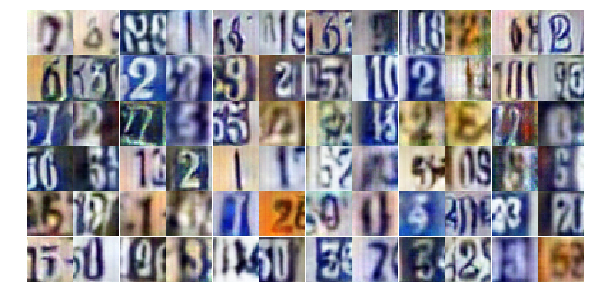

Epoch 23/25... Discriminator Loss: 0.8663... Generator Loss: 0.8245
Epoch 23/25... Discriminator Loss: 0.9666... Generator Loss: 0.6755
Epoch 23/25... Discriminator Loss: 1.2877... Generator Loss: 0.4430
Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.3006
Epoch 23/25... Discriminator Loss: 1.0318... Generator Loss: 2.6298
Epoch 23/25... Discriminator Loss: 0.8710... Generator Loss: 1.1969
Epoch 23/25... Discriminator Loss: 0.9974... Generator Loss: 0.9386
Epoch 23/25... Discriminator Loss: 0.7978... Generator Loss: 1.1102
Epoch 23/25... Discriminator Loss: 0.8663... Generator Loss: 0.8365
Epoch 23/25... Discriminator Loss: 0.5867... Generator Loss: 1.3425


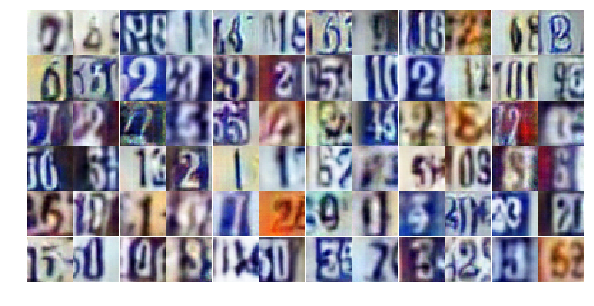

Epoch 23/25... Discriminator Loss: 0.6844... Generator Loss: 1.5030
Epoch 23/25... Discriminator Loss: 1.5037... Generator Loss: 0.3812
Epoch 23/25... Discriminator Loss: 1.0838... Generator Loss: 0.6491
Epoch 23/25... Discriminator Loss: 0.3558... Generator Loss: 2.1028
Epoch 23/25... Discriminator Loss: 0.7822... Generator Loss: 0.8787
Epoch 23/25... Discriminator Loss: 0.5565... Generator Loss: 1.3904
Epoch 23/25... Discriminator Loss: 0.7791... Generator Loss: 0.8813
Epoch 24/25... Discriminator Loss: 0.5957... Generator Loss: 1.1816
Epoch 24/25... Discriminator Loss: 0.7934... Generator Loss: 0.9207
Epoch 24/25... Discriminator Loss: 1.4421... Generator Loss: 0.4006


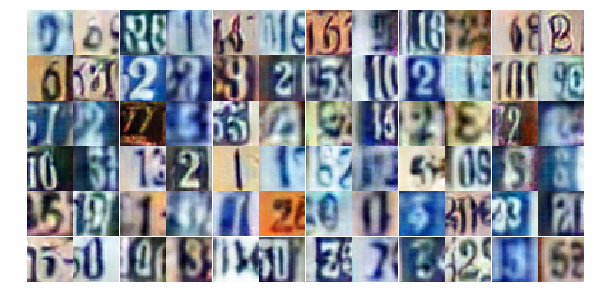

Epoch 24/25... Discriminator Loss: 0.6090... Generator Loss: 1.4986
Epoch 24/25... Discriminator Loss: 0.5275... Generator Loss: 1.5110
Epoch 24/25... Discriminator Loss: 0.8501... Generator Loss: 0.8309
Epoch 24/25... Discriminator Loss: 1.3714... Generator Loss: 2.6110
Epoch 24/25... Discriminator Loss: 0.9070... Generator Loss: 0.7566
Epoch 24/25... Discriminator Loss: 0.5877... Generator Loss: 1.1667
Epoch 24/25... Discriminator Loss: 0.8303... Generator Loss: 0.8473
Epoch 24/25... Discriminator Loss: 1.0770... Generator Loss: 0.5926
Epoch 24/25... Discriminator Loss: 0.4642... Generator Loss: 1.3479
Epoch 24/25... Discriminator Loss: 0.5518... Generator Loss: 1.2931


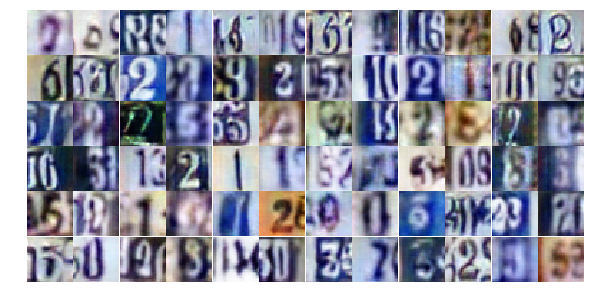

Epoch 24/25... Discriminator Loss: 1.1226... Generator Loss: 0.5831
Epoch 24/25... Discriminator Loss: 0.8891... Generator Loss: 0.9491
Epoch 24/25... Discriminator Loss: 1.4528... Generator Loss: 0.4175
Epoch 24/25... Discriminator Loss: 0.7848... Generator Loss: 0.8388
Epoch 24/25... Discriminator Loss: 0.4905... Generator Loss: 2.9842
Epoch 24/25... Discriminator Loss: 0.8622... Generator Loss: 0.9768
Epoch 24/25... Discriminator Loss: 0.6102... Generator Loss: 1.1249
Epoch 24/25... Discriminator Loss: 1.2891... Generator Loss: 0.4802
Epoch 24/25... Discriminator Loss: 0.7346... Generator Loss: 0.9751
Epoch 24/25... Discriminator Loss: 0.6167... Generator Loss: 1.4183


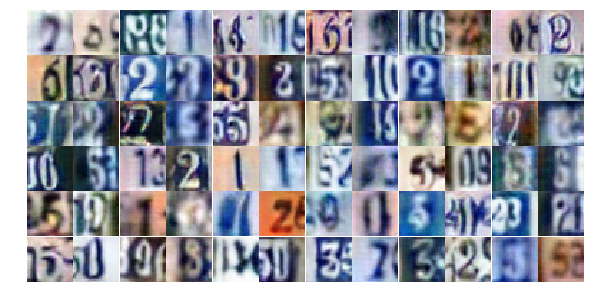

Epoch 24/25... Discriminator Loss: 1.3933... Generator Loss: 0.4547
Epoch 24/25... Discriminator Loss: 0.7465... Generator Loss: 0.9340
Epoch 24/25... Discriminator Loss: 0.6026... Generator Loss: 1.4392
Epoch 24/25... Discriminator Loss: 1.5601... Generator Loss: 0.3963
Epoch 24/25... Discriminator Loss: 0.4907... Generator Loss: 1.3151
Epoch 24/25... Discriminator Loss: 0.5015... Generator Loss: 1.4192
Epoch 24/25... Discriminator Loss: 0.4548... Generator Loss: 1.8488
Epoch 24/25... Discriminator Loss: 0.8093... Generator Loss: 0.9595
Epoch 24/25... Discriminator Loss: 0.5671... Generator Loss: 1.1830
Epoch 24/25... Discriminator Loss: 0.7028... Generator Loss: 1.0190


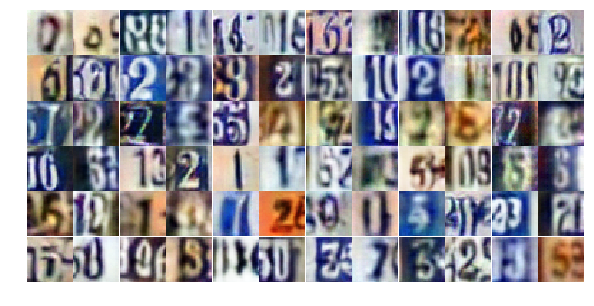

Epoch 24/25... Discriminator Loss: 0.4544... Generator Loss: 1.5015
Epoch 24/25... Discriminator Loss: 0.7584... Generator Loss: 0.9037
Epoch 24/25... Discriminator Loss: 0.7007... Generator Loss: 1.0184
Epoch 24/25... Discriminator Loss: 1.7087... Generator Loss: 0.3438
Epoch 24/25... Discriminator Loss: 0.8684... Generator Loss: 1.7721
Epoch 24/25... Discriminator Loss: 0.9766... Generator Loss: 0.7320
Epoch 24/25... Discriminator Loss: 1.1148... Generator Loss: 0.6142
Epoch 24/25... Discriminator Loss: 1.1687... Generator Loss: 0.5768
Epoch 24/25... Discriminator Loss: 0.7771... Generator Loss: 1.0657
Epoch 24/25... Discriminator Loss: 0.6255... Generator Loss: 1.3198


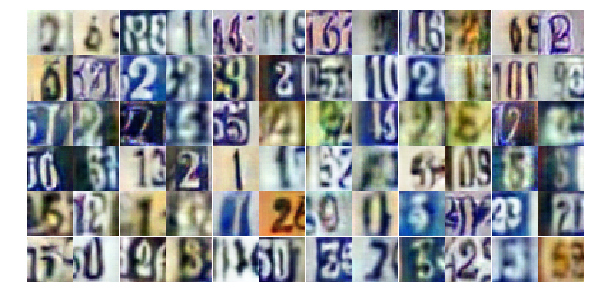

Epoch 24/25... Discriminator Loss: 0.9368... Generator Loss: 0.8089
Epoch 24/25... Discriminator Loss: 1.0690... Generator Loss: 0.6484
Epoch 24/25... Discriminator Loss: 1.4923... Generator Loss: 0.4004
Epoch 24/25... Discriminator Loss: 0.8039... Generator Loss: 1.5687
Epoch 24/25... Discriminator Loss: 1.7674... Generator Loss: 0.2917
Epoch 24/25... Discriminator Loss: 0.7588... Generator Loss: 0.8490
Epoch 24/25... Discriminator Loss: 0.9344... Generator Loss: 0.8109
Epoch 24/25... Discriminator Loss: 0.6069... Generator Loss: 1.1310
Epoch 24/25... Discriminator Loss: 0.7230... Generator Loss: 0.9824
Epoch 24/25... Discriminator Loss: 0.7648... Generator Loss: 1.0014


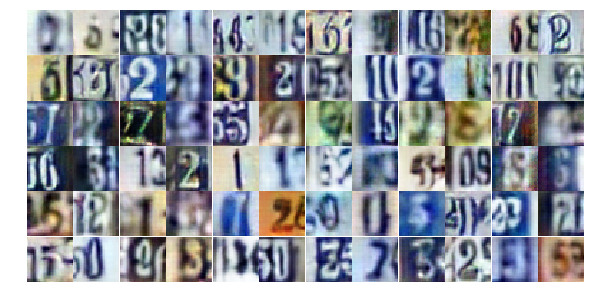

Epoch 24/25... Discriminator Loss: 1.0496... Generator Loss: 0.7273
Epoch 24/25... Discriminator Loss: 1.1353... Generator Loss: 0.6172
Epoch 24/25... Discriminator Loss: 1.7949... Generator Loss: 0.2715
Epoch 24/25... Discriminator Loss: 2.5086... Generator Loss: 2.4569
Epoch 24/25... Discriminator Loss: 1.3160... Generator Loss: 1.8510
Epoch 25/25... Discriminator Loss: 1.4341... Generator Loss: 0.4625
Epoch 25/25... Discriminator Loss: 0.6581... Generator Loss: 1.2157
Epoch 25/25... Discriminator Loss: 0.6148... Generator Loss: 1.5859
Epoch 25/25... Discriminator Loss: 0.8802... Generator Loss: 0.8087
Epoch 25/25... Discriminator Loss: 0.6744... Generator Loss: 1.3097


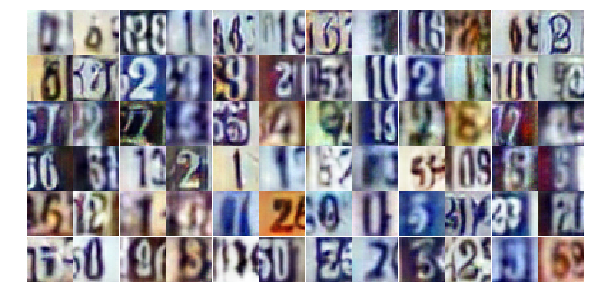

Epoch 25/25... Discriminator Loss: 0.9706... Generator Loss: 0.7510
Epoch 25/25... Discriminator Loss: 0.9970... Generator Loss: 0.7200
Epoch 25/25... Discriminator Loss: 0.7267... Generator Loss: 1.1354
Epoch 25/25... Discriminator Loss: 0.9179... Generator Loss: 0.7891
Epoch 25/25... Discriminator Loss: 0.9105... Generator Loss: 0.8624
Epoch 25/25... Discriminator Loss: 0.9417... Generator Loss: 0.8067
Epoch 25/25... Discriminator Loss: 0.7237... Generator Loss: 1.0688
Epoch 25/25... Discriminator Loss: 0.9661... Generator Loss: 0.7096
Epoch 25/25... Discriminator Loss: 0.4871... Generator Loss: 1.3690
Epoch 25/25... Discriminator Loss: 1.0708... Generator Loss: 0.6253


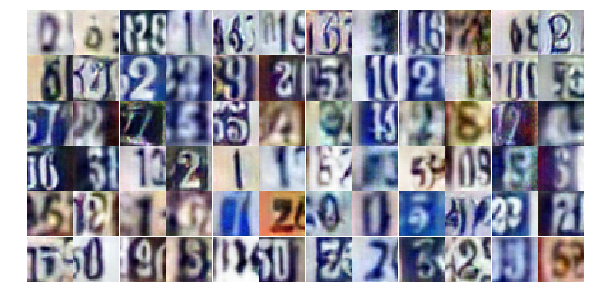

Epoch 25/25... Discriminator Loss: 0.8780... Generator Loss: 0.8826
Epoch 25/25... Discriminator Loss: 0.3847... Generator Loss: 2.3944
Epoch 25/25... Discriminator Loss: 1.3692... Generator Loss: 0.4538
Epoch 25/25... Discriminator Loss: 0.8312... Generator Loss: 1.2691
Epoch 25/25... Discriminator Loss: 0.8836... Generator Loss: 0.8334
Epoch 25/25... Discriminator Loss: 1.2492... Generator Loss: 0.5190
Epoch 25/25... Discriminator Loss: 0.6925... Generator Loss: 1.2293
Epoch 25/25... Discriminator Loss: 1.0649... Generator Loss: 0.6544
Epoch 25/25... Discriminator Loss: 0.5513... Generator Loss: 1.2365
Epoch 25/25... Discriminator Loss: 0.5539... Generator Loss: 1.2980


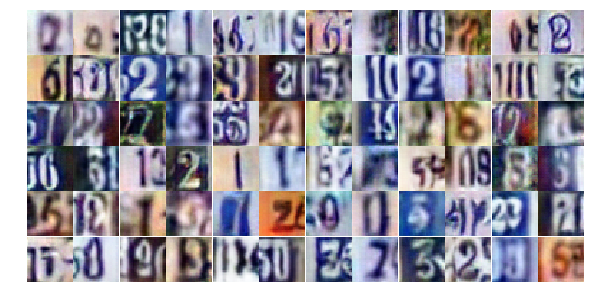

Epoch 25/25... Discriminator Loss: 1.1775... Generator Loss: 0.5281
Epoch 25/25... Discriminator Loss: 0.7171... Generator Loss: 0.9370
Epoch 25/25... Discriminator Loss: 0.9714... Generator Loss: 0.7251
Epoch 25/25... Discriminator Loss: 0.5223... Generator Loss: 1.3200
Epoch 25/25... Discriminator Loss: 1.1454... Generator Loss: 0.6320
Epoch 25/25... Discriminator Loss: 0.6426... Generator Loss: 1.1834
Epoch 25/25... Discriminator Loss: 0.9010... Generator Loss: 0.8467
Epoch 25/25... Discriminator Loss: 1.0127... Generator Loss: 0.6377
Epoch 25/25... Discriminator Loss: 0.8649... Generator Loss: 1.2822
Epoch 25/25... Discriminator Loss: 0.2785... Generator Loss: 2.2284


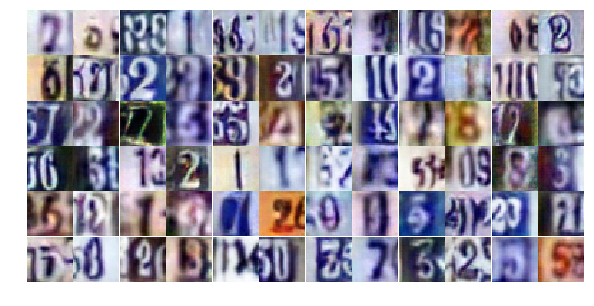

Epoch 25/25... Discriminator Loss: 0.9442... Generator Loss: 0.7253
Epoch 25/25... Discriminator Loss: 0.6838... Generator Loss: 1.0266
Epoch 25/25... Discriminator Loss: 0.8727... Generator Loss: 0.8110
Epoch 25/25... Discriminator Loss: 0.9755... Generator Loss: 0.6782
Epoch 25/25... Discriminator Loss: 1.0949... Generator Loss: 0.7275
Epoch 25/25... Discriminator Loss: 0.9096... Generator Loss: 0.7928
Epoch 25/25... Discriminator Loss: 0.4943... Generator Loss: 1.3723
Epoch 25/25... Discriminator Loss: 0.5022... Generator Loss: 1.2577
Epoch 25/25... Discriminator Loss: 2.2105... Generator Loss: 0.2799
Epoch 25/25... Discriminator Loss: 0.6590... Generator Loss: 1.3466


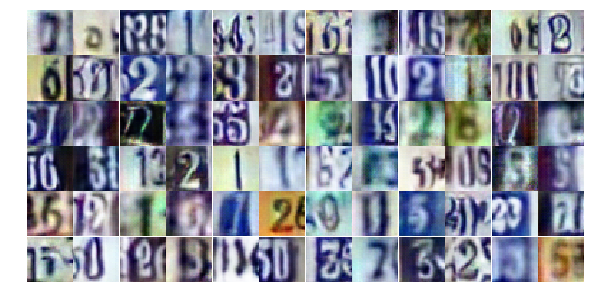

Epoch 25/25... Discriminator Loss: 1.0046... Generator Loss: 0.6883
Epoch 25/25... Discriminator Loss: 0.4606... Generator Loss: 1.8483
Epoch 25/25... Discriminator Loss: 0.8294... Generator Loss: 0.9436
Epoch 25/25... Discriminator Loss: 0.7319... Generator Loss: 1.0070
Epoch 25/25... Discriminator Loss: 1.2237... Generator Loss: 0.5188
Epoch 25/25... Discriminator Loss: 0.4262... Generator Loss: 1.6390
Epoch 25/25... Discriminator Loss: 1.4302... Generator Loss: 0.4741


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))